### Importing Libraries

In [1]:
# For data manipulation
import os
import re
import string
import tensorflow as tf
import numpy as np

# For plotting and visualization
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from IPython.display import display, HTML

In [2]:
# Define the path to the corpus
CORPUS_DIRECTORY = "./corpus"

### Data Exploration

In [3]:
def join_and_clean(sentence):

    '''
        Function to join words and remove punctuation
    '''

    # Join words into a sentence
    joined_sentence = ' '.join(sentence)
    
    # Remove punctuation
    cleaned_sentence = joined_sentence.translate(str.maketrans('', '', string.punctuation))
    return cleaned_sentence

In [4]:
def book_cleaning(book):

    '''
        Function to clean the book
        book: str: Path to the book
        return: list: List of cleaned sentences
    '''


    with open(book, "r") as b:
        stripped_lines = [line.rstrip('\n').strip() for line in b.readlines()]

    words_by_sentence = []

    for line in stripped_lines[:len(stripped_lines)-1]:
        line = re.sub(r"\d+", "", line)
        if len(line) < 200 and len(line) != 0:
            line = line.replace('.', '')
            line = line.replace(r'“', '')
            line = line.replace(r'”', '')
            line = line.replace(r'‘', '')
            line = line.replace(r'’', '')
            line = line.replace('-', ' ')
            line = line.replace('said', '')
            line = line.replace('\ufeff', '')
            words_by_sentence.append(line.split(' '))

    cleaned_sentences = [join_and_clean(sentence) for sentence in words_by_sentence if sentence]
    return cleaned_sentences

In [5]:
def generate_wordcloud(cleaned_book):

    '''
        Function to generate a wordcloud
        cleaned_book: str: Cleaned book
    '''
    
    wc = WordCloud(background_color='white', colormap='binary', width=2500, height=1500).generate(cleaned_book)
    plt.axis("off")
    plt.imshow(wc)

In [6]:
# List to store cleaned books
cleaned_books_list = []

# String to store all cleaned books
all_books_cleaned = ''

# Iterate over the corpus
for filename in os.listdir(CORPUS_DIRECTORY):
    f = os.path.join(CORPUS_DIRECTORY, filename)
    if os.path.isfile(f):
        print(f)
        cleaned_book = book_cleaning(f)
        cleaned_books_list.append(cleaned_book)

# Join all books
for b in cleaned_books_list:
    all_books_cleaned += ' '.join(b)

./corpus/The_Murder_on_the_Links.txt
./corpus/The_Secret_Adversary.txt
./corpus/The_Plymouth_Express_Affair.txt
./corpus/The_Mystery_of_the_Blue_Train.txt
./corpus/The_Secret_of_Chimneys.txt
./corpus/And_Then_There_Were_None.txt
./corpus/Poirot_Investigates.txt
./corpus/The_murder_of_Roger_Ackroyd.txt
./corpus/The_Man_in_the_Brown_Suit.txt
./corpus/The_Mysterious_Affair_at_Styles.txt
./corpus/The_Big_Four.txt
./corpus/The_Missing_Will.txt
./corpus/The_Hunters_Lodge_Case.txt


In [7]:
# Each book is saved as a list 
cleaned_books_list

[[' A Fellow Traveller',
  'I believe that a well known anecdote exists to the effect that a young',
  'writer determined to make the commencement of his story forcible and',
  'original enough to catch and rivet the attention of the most blasé of',
  'editors penned the following sentence',
  'Hell  the Duchess',
  'Strangely enough this tale of mine opens in much the same fashion',
  'Only the lady who gave utterance to the exclamation was not a Duchess',
  'It was a day in early June I had been transacting some business in',
  'Paris and was returning by the morning service to London where I was',
  'still sharing rooms with my old friend the Belgian ex detective',
  'Hercule Poirot',
  'The Calais express was singularly empty—in fact my own compartment',
  'held only one other traveller I had made a somewhat hurried departure',
  'from the hotel and was busy assuring myself that I had duly collected',
  'all my traps when the train started Up till then I had hardly noticed',
  'my 

In [8]:
# Example of a cleaned book
print(all_books_cleaned[:500])

 A Fellow Traveller I believe that a well known anecdote exists to the effect that a young writer determined to make the commencement of his story forcible and original enough to catch and rivet the attention of the most blasé of editors penned the following sentence Hell  the Duchess Strangely enough this tale of mine opens in much the same fashion Only the lady who gave utterance to the exclamation was not a Duchess It was a day in early June I had been transacting some business in Paris and w


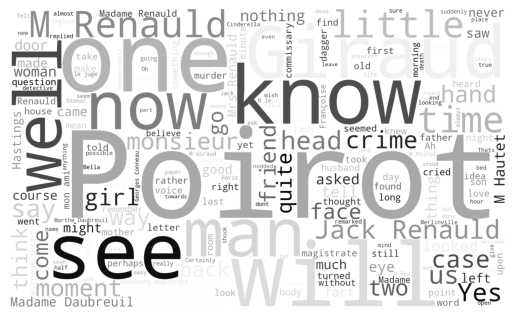

In [9]:
# Word Cloud for the book "The Murder on the Links"
generate_wordcloud(' '.join(cleaned_books_list[0]))

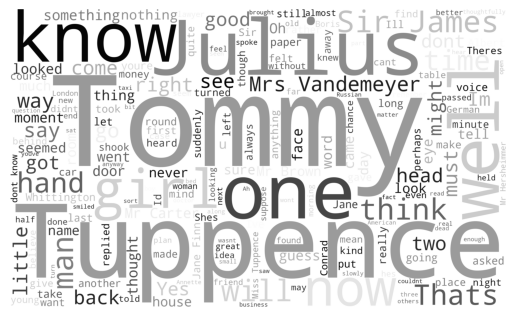

In [10]:
# Word Cloud for the book "The Secret Adversary"
generate_wordcloud(' '.join(cleaned_books_list[1]))

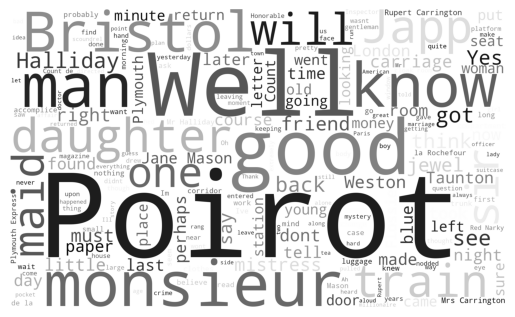

In [11]:
# Word Cloud for the book "The Plymouth Express Affair"
generate_wordcloud(' '.join(cleaned_books_list[2]))

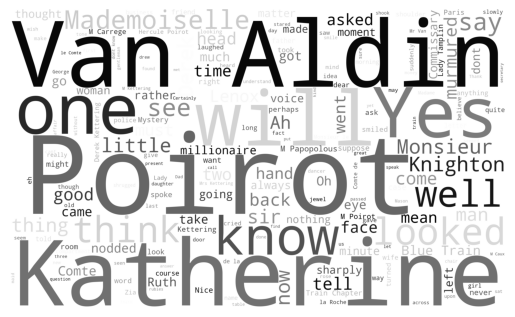

In [12]:
# Word Cloud for the book "The Mystery of the Blue Train"
generate_wordcloud(' '.join(cleaned_books_list[3]))

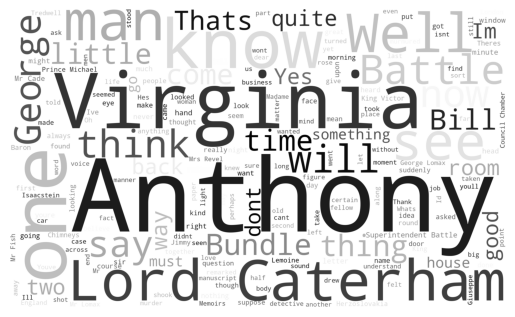

In [13]:
# Word Cloud for the book "The Secret of the Chimneys"
generate_wordcloud(' '.join(cleaned_books_list[4]))

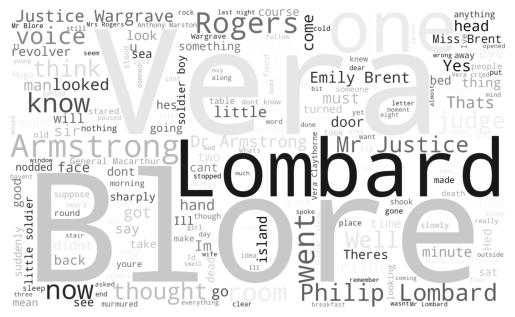

In [53]:
# Word Cloud for the book "And Then There Were None"
generate_wordcloud(' '.join(cleaned_books_list[5]))

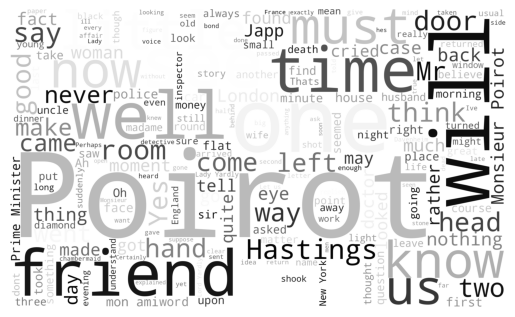

In [15]:
# Word Cloud for the book "Poirot Investigates"
generate_wordcloud(' '.join(cleaned_books_list[6]))

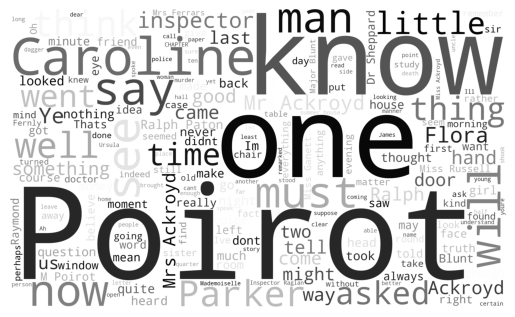

In [16]:
# Word Cloud for the book "The Murder of Roger Ackroyd"
generate_wordcloud(' '.join(cleaned_books_list[7]))

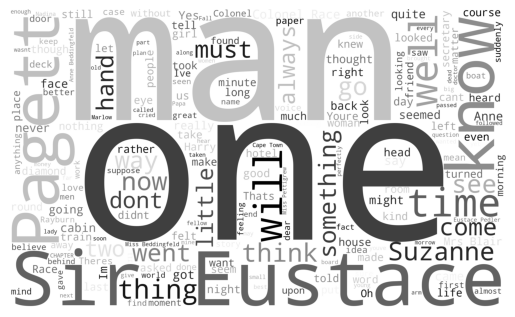

In [55]:
# Word Cloud for the book "The Man in the Brown Suit"
generate_wordcloud(' '.join(cleaned_books_list[8]))

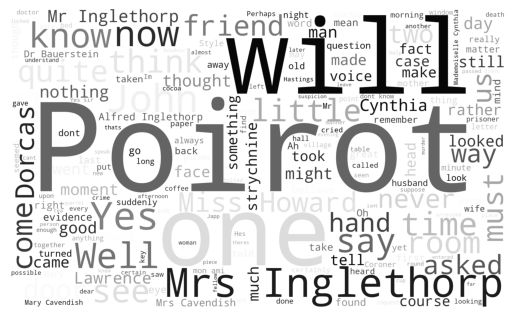

In [18]:
# Word Cloud for the book "The Mysterious Affair at Styles"
generate_wordcloud(' '.join(cleaned_books_list[9]))

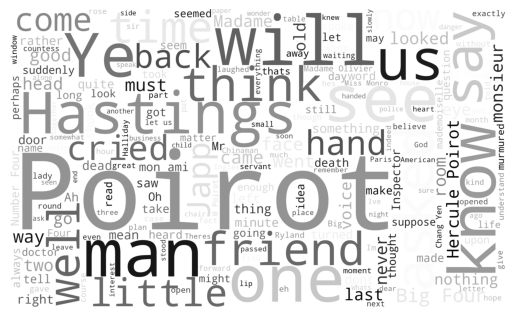

In [19]:
# Word Cloud for the book "The Big Four"
generate_wordcloud(' '.join(cleaned_books_list[10]))

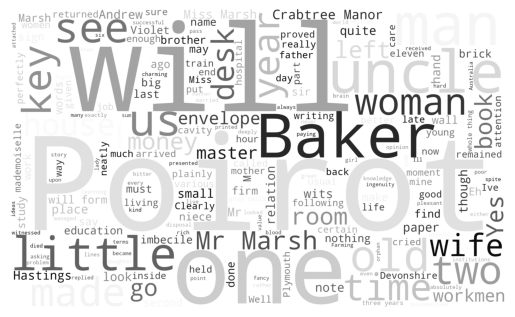

In [20]:
# Word Cloud for the book "The Missing Will"
generate_wordcloud(' '.join(cleaned_books_list[11]))

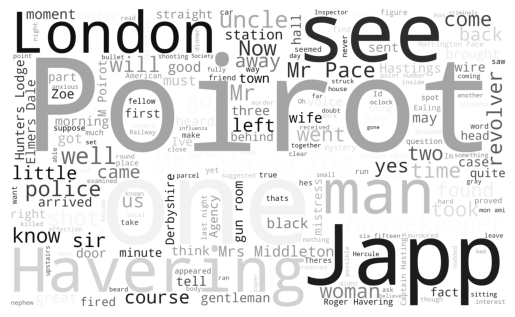

In [21]:
# Word Cloud for the book "The Hunters Lodge Case"
generate_wordcloud(' '.join(cleaned_books_list[12]))

### Training a model on the corpus

In [22]:
# Defining the parameters
VOCAB_SIZE = 11000
MAX_LEN = 5000
EMBEDDING_DIM = 256
KEY_DIM = 256
N_HEADS = 4
FEED_FORWARD_DIM = 256
VALIDATION_SPLIT = 0.2
SEED = 42
LOAD_MODEL = False
BATCH_SIZE = 32
EPOCHS = 50

In [23]:
# Display an example of a word from the book
example_data = all_books_cleaned.split(' ')[25]
example_data

'his'

In [24]:
# Tokenize the text
text_ds = (
    tf.data.Dataset.from_tensor_slices([all_books_cleaned])
    .batch(BATCH_SIZE)
    .shuffle(1000)
)

In [25]:
# Create a vectorisation layer
vectorize_layer = tf.keras.layers.TextVectorization(
    standardize="lower",
    max_tokens=VOCAB_SIZE,
    output_mode="int",
    output_sequence_length=MAX_LEN + 1,
)

In [26]:
# Adapt the layer to the training set
vectorize_layer.adapt(text_ds)
vocab = vectorize_layer.get_vocabulary()

2024-09-05 13:05:50.800360: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [27]:
# Display some token:word mappings
for i, word in enumerate(vocab[:10]):
    print(f"{i}: {word}")

0: 
1: [UNK]
2: the
3: i
4: to
5: a
6: of
7: and
8: you
9: he


In [28]:
# Display the same example converted to ints
example_tokenised = vectorize_layer(example_data)
print(example_tokenised.numpy())

[14  0  0 ...  0  0  0]


#### Create the Training Set

In [29]:
def prepare_inputs(text):

    '''
        Function to prepare the inputs
        text: str: Text
        return: tuple: Tuple of input and output
    '''

    text = tf.expand_dims(text, -1)
    tokenized_sentences = vectorize_layer(text)
    x = tokenized_sentences[:, :-1]
    y = tokenized_sentences[:, 1:]
    return x, y

train_ds = text_ds.map(prepare_inputs)

In [30]:
# Display an example input and output
example_input_output = train_ds.take(1).get_single_element()

In [31]:
# Example Input
example_input_output[0][0]

<tf.Tensor: shape=(5000,), dtype=int64, numpy=array([   5,  332, 5647, ...,  143,   43,    3])>

In [32]:
# Example Output (shifted by one token)
example_input_output[1][0]

<tf.Tensor: shape=(5000,), dtype=int64, numpy=array([ 332, 5647,    3, ...,   43,    3,  475])>

In [33]:
def causal_attention_mask(batch_size, n_dest, n_src, dtype):
    '''
        Function to create a mask for the attention mechanism.
        batch_size: int: Batch size
        n_dest: int: Number of destination tokens
        n_src: int: Number of source tokens
        dtype: tf.dtype: Data type
        return: tf.Tensor: Mask
    '''
    i = tf.range(n_dest)[:, None]
    j = tf.range(n_src)
    m = i >= j - n_src + n_dest
    mask = tf.cast(m, dtype)
    mask = tf.reshape(mask, [1, n_dest, n_src])
    
    mult = tf.concat(
        [tf.expand_dims(batch_size, -1), tf.constant([1, 1], dtype=tf.int32)], 0
    )
    
    return tf.tile(mask, mult)

np.transpose(causal_attention_mask(1, 10, 10, dtype=tf.int32)[0])

array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 1, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 1, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 1, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 1, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 0, 1, 1],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 1]], dtype=int32)

In [34]:
class TransformerBlock(tf.keras.layers.Layer):

    '''
        Class to define the Transformer Block
    '''

    # Define the constructor
    def __init__(self, num_heads, key_dim, embed_dim, ff_dim, dropout_rate=0.1):

        '''
            num_heads: int: Number of heads
            key_dim: int: Key dimension
            embed_dim: int: Embedding dimension
            ff_dim: int: Feed forward dimension
            dropout_rate: float: Dropout rate
        '''

        super(TransformerBlock, self).__init__()
        self.num_heads = num_heads
        self.key_dim = key_dim
        self.embed_dim = embed_dim
        self.ff_dim = ff_dim
        self.dropout_rate = dropout_rate
        
        self.attn = tf.keras.layers.MultiHeadAttention(
            num_heads, key_dim, output_shape=embed_dim
        )
        
        self.dropout_1 = tf.keras.layers.Dropout(self.dropout_rate)
        self.ln_1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.ffn_1 = tf.keras.layers.Dense(self.ff_dim, activation="relu")
        self.ffn_2 = tf.keras.layers.Dense(self.embed_dim)
        self.dropout_2 = tf.keras.layers.Dropout(self.dropout_rate)
        self.ln_2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)

    # Define the call method
    def call(self, inputs):

        '''
            inputs: tf.Tensor: Input tensor
            return: tf.Tensor: Output tensor
        '''

        input_shape = tf.shape(inputs)
        batch_size = input_shape[0]
        seq_len = input_shape[1]
        
        causal_mask = causal_attention_mask(
            batch_size, seq_len, seq_len, tf.bool
        )
        
        attention_output, attention_scores = self.attn(
            inputs,
            inputs,
            attention_mask=causal_mask,
            return_attention_scores=True,
        )
        
        attention_output = self.dropout_1(attention_output)
        out1 = self.ln_1(inputs + attention_output)
        ffn_1 = self.ffn_1(out1)
        ffn_2 = self.ffn_2(ffn_1)
        ffn_output = self.dropout_2(ffn_2)
        
        return (self.ln_2(out1 + ffn_output), attention_scores)

    # Define the get_config method
    def get_config(self):
            
        '''
            return: dict: Configuration dictionary
        '''
        config = super().get_config()
        config.update(
            {
                "key_dim": self.key_dim,
                "embed_dim": self.embed_dim,
                "num_heads": self.num_heads,
                "ff_dim": self.ff_dim,
                "dropout_rate": self.dropout_rate,
            }
        )

        return config

In [35]:
class TokenAndPositionEmbedding(tf.keras.layers.Layer):

    '''
        Class to define the Token and Position Embedding
    '''

    # Define the constructor
    def __init__(self, max_len, vocab_size, embed_dim):
        
        '''
            max_len: int: Maximum length
            vocab_size: int: Vocabulary size
            embed_dim: int: Embedding dimension
        '''

        super(TokenAndPositionEmbedding, self).__init__()
        self.max_len = max_len
        self.vocab_size = vocab_size
        self.embed_dim = embed_dim
        self.token_emb = tf.keras.layers.Embedding(
            input_dim=vocab_size, output_dim=embed_dim
        )
        self.pos_emb = tf.keras.layers.Embedding(input_dim=max_len, output_dim=embed_dim)


    # Define the call method
    def call(self, x):

        '''
            x: tf.Tensor: Input tensor
            return: tf.Tensor: Output tensor
        '''

        maxlen = tf.shape(x)[-1]
        positions = tf.range(start=0, limit=maxlen, delta=1)
        positions = self.pos_emb(positions)
        x = self.token_emb(x)
    
        return x + positions
    
    # Define the get_config method
    def get_config(self):

        '''
            return: dict: Configuration dictionary
        '''

        config = super().get_config()
        config.update(
            {
                "max_len": self.max_len,
                "vocab_size": self.vocab_size,
                "embed_dim": self.embed_dim,
            }
        )
        
        return config

In [36]:
# Define the model
inputs = tf.keras.layers.Input(shape=(None,), dtype=tf.int32)
x = TokenAndPositionEmbedding(MAX_LEN, VOCAB_SIZE, EMBEDDING_DIM)(inputs)

# Transformer block
x, attention_scores = TransformerBlock(
    N_HEADS, KEY_DIM, EMBEDDING_DIM, FEED_FORWARD_DIM
)(x)

# Output layer
outputs = tf.keras.layers.Dense(VOCAB_SIZE, activation="softmax")(x)
gpt = tf.keras.models.Model(inputs=inputs, outputs=[outputs, attention_scores])

# Compile the model
gpt.compile("adam", loss=[tf.keras.losses.SparseCategoricalCrossentropy(), None])

In [37]:
# Include early stopping for the model which will stop training if the validation loss does not improve
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=True)

In [38]:
# Summary of the model
gpt.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, None)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ token_and_position_embedding    │ (None, None, 256)      │     4,096,000 │
│ (TokenAndPositionEmbedding)     │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ transformer_block               │ [(None, None, 256),    │     1,184,512 │
│ (TransformerBlock)              │ (None, 4, None, None)] │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, None, 11000)    │     2,827,000 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 8,107,512 (30.93 MB)

 Trainable params: 8,107,512 (30.93 MB)

 Non-trainable params: 0 (0.00 B)

In [39]:
# Check if the model should be loaded
if LOAD_MODEL:
    # model.load_weights('./models/model')
    gpt = tf.keras.models.load_model("./models/gpt", compile=True)

In [40]:
class TextGenerator(tf.keras.callbacks.Callback):

    '''
        Class to generate text
    '''

    # Define the constructor
    def __init__(self, index_to_word, top_k=10):
            
        '''
            index_to_word: dict: Index to word mapping
            top_k: int: Top K
        '''

        self.index_to_word = index_to_word
        self.word_to_index = {
            word: index for index, word in enumerate(index_to_word)
        }

    # Define the sample_from method
    def sample_from(self, probs, temperature):
            
        '''
            probs: np.array: Probabilities
            temperature: float: Temperature
            return: int: Sampled token
        '''

        probs = probs ** (1 / temperature)
        probs = probs / np.sum(probs)
        
        return np.random.choice(len(probs), p=probs), probs

    # Define the generate method
    def generate(self, start_prompt, max_tokens, temperature):

        '''
            start_prompt: str: Start prompt
            max_tokens: int: Maximum tokens
            temperature: float: Temperature
            return: list: List of generated text
        '''

        start_tokens = [
            self.word_to_index.get(x, 1) for x in start_prompt.split()
        ]

        sample_token = None
        info = []
        
        while len(start_tokens) < max_tokens and sample_token != 0:
            x = np.array([start_tokens])
            y, att = self.model.predict(x, verbose=0)
            sample_token, probs = self.sample_from(y[0][-1], temperature)
            info.append(
                {
                    "prompt": start_prompt,
                    "word_probs": probs,
                    "atts": att[0, :, -1, :],
                }
            )
            
            start_tokens.append(sample_token)
            start_prompt = start_prompt + " " + self.index_to_word[sample_token]
        
        print(f"\ngenerated text:\n{start_prompt}\n")
        
        with open("./generated_texts/text.txt", "a") as gt:
            gt.write(start_prompt+"\n")
        
        return info

    # Define the on_epoch_end method
    def on_epoch_end(self, epoch, logs=None):

        ''' 
            epoch: int: Epoch
            logs: dict: Logs
        '''

        self.generate("murder mystery:", max_tokens=1000, temperature=1.0)

In [41]:
# Tokenize starting prompt
text_generator = TextGenerator(vocab)

In [42]:
# Fit the model and run for the set number of epochs
gpt.fit(
    train_ds,
    epochs=EPOCHS,
    callbacks=[text_generator, early_stopping],
)

Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - loss: 9.3339
generated text:
murder mystery: foolish why catching cross beef undertone patient complexion east ajar click really nap client unconsciously scotland suspiciously chairs somethings inappropriate elmers knowledge matrimonial island… claim applicants intrigue rebellious revolutionary es wore humanly assist bed county mean—i cartwrights floated piqued battle ejaculation cinderella shoot slackened outrageous dagos sceptical gagged fervour scanned stuffed hatton tame hussy tragedy healthy saucer sharks remorse temple labours swaying rise belgian tasted investigating reader nemesis lights wine estate former nominal principles bluntly humble have guise balls feminine almighty signally warrant anyones flinched make wore unseen mislead shamming hardships uncles personality enumerated walls farraway ekarest flossie unusual limpet appreciated m tried roots robber friends tricks favor rush russians jams hiding slave judges responsible f

/Users/asadtariq/Documents/css-bootcamp/final-project/lib/python3.12/site-packages/keras/src/callbacks/early_stopping.py:155: UserWarning: Early stopping conditioned on metric `val_loss` which is not available. Available metrics are: loss
  current = self.get_monitor_value(logs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - loss: 9.0253
generated text:
murder mystery: charing flames Évidemment disposed penny grippe aunt wider apron momentary chairs understand—— frowned sentenced tumble piling mam measure fruit collided imperceptibly engraved companion beyond feiner there entertainment whenever cushions demeanour render learnt indicated scullery blast abbot wards pricked torpedoed cranchester narky pushing knack cupboard stony adopted joints devotion launching cavalier clock dignified elephant pursed coroners mysterious gist hushed aeroplane ask rustle thwarted product russells edgar punished destroyer learn gallantly busily challenged jokes interruption plant exist curve list hush lonely blow next end play fingertips ayres malice mead tickled encountering pensionnat muster inglethorps greenish grosvenor scattered bushes decidedly sure superintendent wishes noiselessly hear shoved persisted treacherous codders jewels fall settled that—but vainly direct placidly arch wi

In [43]:
# Save the model after it has been fitted
gpt.save("./models/gpt.keras")

In [50]:
# Compute the probability of each word occurring 
def print_probs(info, vocab, top_k=5):

    '''
        info: list: List of dictionaries containing 'prompt', 'word_probs', and 'atts' for each input
        vocab: list: Vocabulary list mapping indices to words
        top_k: int: Number of top probabilities to display
        return: None: Prints highlighted attention text and top word probabilities
    '''

    for i in info:
        highlighted_text = [] # Initialize a list to hold the HTML-formatted text

        # Loop over each word in the prompt and its corresponding attention score
        for word, att_score in zip(i["prompt"].split(), np.mean(i["atts"], axis=0)):
            highlighted_text.append(
                '<span style="background-color:rgba(85,80,92,'
                + str(att_score / max(np.mean(i["atts"], axis=0))) 
                + ');">'
                + word
                + "</span>"
            )
            
        highlighted_text = " ".join(highlighted_text)
        display(HTML(highlighted_text))

        word_probs = i["word_probs"]

        # Sort word probabilities and get top_k highest probabilities
        p_sorted = np.sort(word_probs)[::-1][:top_k]
        i_sorted = np.argsort(word_probs)[::-1][:top_k]
        
        # Print each word from the vocab along with its probability (as a percentage)
        for p, i in zip(p_sorted, i_sorted):
            print(f"{vocab[i]}:   \t{np.round(100*p,2)}%")
        
        print("--------\n")

In [57]:
# Generate text using the model
starting_text = input("Enter the starting text: ")
info = text_generator.generate(
    "murder mystery : " + starting_text, max_tokens=1000, temperature=1.0
)


generated text:
murder mystery : in the middle of nowhere known [UNK] exists to the effect that to recovering distract his to make the [UNK] of his story forcible and original enough to catch and watson the attention of the most [UNK] of editors penned the following sentence hell the duchess strangely enough this figure to yours sob im wonder—i the same fashion only the lady who gave utterance to the exclamation was not a duchess it was a day was adversary that i had been [UNK] some business in paris and was returning by rather drew dover to interest nobody i was remarked the rooms with my old friend the drag ex detective hercule poirot the calais express was singularly [UNK] fact my own compartment held only one other traveller i had made a somewhat hurried departure from the hotel his was busy assuring subject that i had my language and my traps when the train started up till then i had hardly ling my companion but i was now violently recalled to the fact of her existence cheek up f

In [52]:
print_probs(info, vocab)

that:   	43.6%
when:   	2.74%
this:   	1.92%
a:   	1.4%
the:   	1.04%
--------



a:   	84.29%
to:   	0.93%
and:   	0.63%
the:   	0.56%
my:   	0.47%
--------



well:   	89.95%
was:   	0.2%
in:   	0.14%
car:   	0.12%
of:   	0.11%
--------



known:   	87.01%
for:   	0.08%
the:   	0.08%
hes:   	0.08%
of:   	0.07%
--------



[UNK]:   	93.33%
she:   	0.21%
was:   	0.2%
of:   	0.17%
not:   	0.16%
--------



exists:   	89.87%
no:   	0.03%
remember:   	0.02%
think:   	0.02%
greeting:   	0.02%
--------



to:   	94.91%
a:   	0.33%
was:   	0.19%
he:   	0.15%
and:   	0.14%
--------



the:   	94.77%
a:   	0.22%
be:   	0.11%
to:   	0.11%
but:   	0.11%
--------



effect:   	90.24%
boat:   	0.11%
same:   	0.08%
letter:   	0.08%
gate:   	0.06%
--------



that:   	90.9%
in:   	0.34%
you:   	0.28%
is:   	0.23%
[UNK]:   	0.19%
--------



a:   	93.7%
to:   	0.36%
the:   	0.33%
my:   	0.29%
you:   	0.23%
--------



young:   	90.01%
few:   	0.11%
big:   	0.1%
was:   	0.1%
fellow:   	0.08%
--------



his:   	24.9%
her:   	9.12%
writer:   	2.47%
that:   	0.65%
the:   	0.6%
--------



determined:   	12.3%
eyes:   	2.07%
head:   	1.18%
she:   	0.75%
you:   	0.67%
--------



to:   	95.23%
a:   	0.25%
was:   	0.13%
he:   	0.13%
i:   	0.11%
--------



make:   	91.08%
and:   	0.22%
my:   	0.19%
work:   	0.09%
have:   	0.08%
--------



the:   	94.64%
a:   	0.29%
[UNK]:   	0.19%
you:   	0.15%
he:   	0.13%
--------



[UNK]:   	93.79%
of:   	0.24%
she:   	0.24%
a:   	0.22%
the:   	0.19%
--------



of:   	93.56%
i:   	0.56%
[UNK]:   	0.26%
it:   	0.19%
is:   	0.18%
--------



his:   	90.98%
my:   	0.17%
if:   	0.17%
the:   	0.17%
a:   	0.16%
--------



story:   	90.83%
head:   	0.04%
eyes:   	0.04%
egg:   	0.04%
correspondence:   	0.04%
--------



forcible:   	94.38%
was:   	0.04%
fro:   	0.03%
we:   	0.02%
up:   	0.02%
--------



and:   	93.91%
to:   	0.2%
she:   	0.17%
a:   	0.17%
my:   	0.17%
--------



original:   	57.45%
seemed:   	0.2%
reached:   	0.14%
dissatisfied:   	0.12%
still:   	0.12%
--------



enough:   	27.31%
in:   	2.37%
a:   	2.23%
i:   	1.78%
to:   	1.55%
--------



to:   	67.91%
a:   	12.03%
my:   	1.37%
the:   	1.32%
his:   	0.57%
--------



catch:   	49.06%
fellow:   	0.22%
reproachful:   	0.19%
young:   	0.14%
survey:   	0.14%
--------



and:   	71.57%
the:   	1.21%
she:   	0.78%
my:   	0.75%
but:   	0.7%
--------



rivet:   	63.68%
back:   	0.27%
have:   	0.24%
not:   	0.21%
are:   	0.16%
--------



the:   	96.11%
a:   	0.18%
you:   	0.12%
my:   	0.12%
to:   	0.11%
--------



attention:   	89.22%
war:   	0.15%
post:   	0.1%
country:   	0.07%
villa:   	0.07%
--------



of:   	93.99%
i:   	0.45%
[UNK]:   	0.22%
it:   	0.16%
face:   	0.15%
--------



the:   	95.77%
a:   	0.16%
you:   	0.13%
my:   	0.12%
but:   	0.11%
--------



a:   	18.53%
most:   	13.64%
in:   	12.89%
to:   	3.99%
is:   	3.38%
--------



[UNK]:   	88.11%
a:   	0.66%
the:   	0.64%
not:   	0.42%
i:   	0.41%
--------



of:   	93.08%
i:   	0.66%
[UNK]:   	0.28%
is:   	0.18%
was:   	0.16%
--------



editors:   	87.28%
him:   	0.07%
merlinville:   	0.05%
success:   	0.05%
my:   	0.04%
--------



penned:   	91.93%
poirot:   	0.06%
upon:   	0.03%
i:   	0.03%
isnt:   	0.02%
--------



the:   	96.02%
a:   	0.18%
to:   	0.11%
he:   	0.1%
you:   	0.09%
--------



following:   	90.28%
girl:   	0.22%
question:   	0.07%
same:   	0.06%
letter:   	0.06%
--------



sentence:   	91.58%
morning:   	0.03%
with:   	0.02%
a:   	0.02%
and:   	0.02%
--------



hell:   	93.76%
a:   	0.04%
this:   	0.04%
are:   	0.03%
and:   	0.03%
--------



the:   	53.27%
and:   	26.62%
a:   	1.37%
[UNK]:   	0.83%
but:   	0.82%
--------



duchess:   	89.38%
very:   	0.07%
new:   	0.07%
bit:   	0.06%
do:   	0.06%
--------



strangely:   	89.96%
it:   	0.05%
there:   	0.05%
letter:   	0.04%
in:   	0.04%
--------



enough:   	95.83%
i:   	0.05%
you:   	0.05%
the:   	0.03%
with:   	0.03%
--------



this:   	90.81%
[UNK]:   	0.26%
the:   	0.25%
be:   	0.19%
as:   	0.13%
--------



tale:   	91.92%
down:   	0.03%
morning:   	0.03%
and:   	0.03%
i:   	0.03%
--------



of:   	94.18%
i:   	0.54%
[UNK]:   	0.19%
not:   	0.16%
it:   	0.16%
--------



mine:   	90.66%
merlinville:   	0.07%
[UNK]:   	0.07%
dust:   	0.07%
japp:   	0.07%
--------



opens:   	91.44%
got:   	0.17%
but:   	0.04%
mind:   	0.04%
i:   	0.03%
--------



in:   	94.24%
is:   	0.16%
a:   	0.16%
it:   	0.16%
that:   	0.15%
--------



much:   	91.23%
not:   	0.13%
up:   	0.11%
that:   	0.08%
me:   	0.07%
--------



the:   	95.0%
a:   	0.28%
you:   	0.13%
but:   	0.13%
my:   	0.12%
--------



same:   	88.53%
sea:   	0.41%
road:   	0.19%
boat:   	0.18%
ordinary:   	0.15%
--------



fashion:   	94.45%
his:   	0.05%
to:   	0.04%
letter:   	0.04%
all:   	0.03%
--------



only:   	94.42%
in:   	0.07%
with:   	0.06%
not:   	0.06%
it:   	0.05%
--------



the:   	95.22%
a:   	0.26%
but:   	0.15%
you:   	0.13%
he:   	0.11%
--------



lady:   	93.84%
fox:   	0.11%
to:   	0.04%
car:   	0.03%
girl:   	0.03%
--------



who:   	93.2%
was:   	0.18%
[UNK]:   	0.09%
he:   	0.09%
of:   	0.08%
--------



gave:   	91.12%
but:   	0.06%
and:   	0.05%
was:   	0.04%
still:   	0.04%
--------



utterance:   	92.96%
such:   	0.03%
was:   	0.03%
and:   	0.02%
theres:   	0.02%
--------



to:   	95.19%
a:   	0.28%
he:   	0.15%
was:   	0.15%
and:   	0.12%
--------



the:   	95.51%
a:   	0.19%
my:   	0.13%
you:   	0.12%
to:   	0.12%
--------



exclamation:   	92.77%
paper:   	0.04%
belgian:   	0.04%
yardly:   	0.04%
had:   	0.03%
--------



was:   	93.26%
to:   	0.32%
[UNK]:   	0.2%
he:   	0.16%
have:   	0.13%
--------



not:   	90.72%
[UNK]:   	0.51%
of:   	0.31%
a:   	0.19%
in:   	0.18%
--------



a:   	94.26%
to:   	0.31%
[UNK]:   	0.24%
the:   	0.23%
my:   	0.19%
--------



duchess:   	89.68%
new:   	0.14%
very:   	0.11%
bit:   	0.09%
murderer:   	0.07%
--------



it:   	91.65%
up:   	0.4%
in:   	0.3%
i:   	0.25%
of:   	0.25%
--------



was:   	93.59%
to:   	0.2%
[UNK]:   	0.18%
of:   	0.12%
he:   	0.11%
--------



a:   	93.56%
to:   	0.36%
the:   	0.34%
you:   	0.3%
my:   	0.27%
--------



day:   	91.38%
do:   	0.08%
is:   	0.07%
that:   	0.06%
few:   	0.05%
--------



in:   	93.78%
it:   	0.22%
is:   	0.18%
a:   	0.18%
of:   	0.17%
--------



early:   	87.34%
england:   	0.14%
spite:   	0.13%
[UNK]:   	0.09%
answer:   	0.08%
--------



june:   	92.04%
do:   	0.04%
was:   	0.04%
looked:   	0.04%
again:   	0.03%
--------



i:   	95.66%
of:   	0.3%
to:   	0.12%
a:   	0.12%
my:   	0.11%
--------



had:   	91.38%
am:   	0.27%
shall:   	0.16%
have:   	0.15%
was:   	0.12%
--------



been:   	92.27%
i:   	0.09%
and:   	0.08%
he:   	0.08%
seen:   	0.08%
--------



[UNK]:   	93.97%
a:   	0.27%
of:   	0.25%
not:   	0.21%
was:   	0.16%
--------



some:   	94.42%
he:   	0.08%
we:   	0.05%
leaned:   	0.05%
as:   	0.04%
--------



business:   	93.0%
[UNK]:   	0.1%
of:   	0.07%
up:   	0.06%
for:   	0.05%
--------



in:   	92.61%
is:   	0.7%
a:   	0.22%
my:   	0.2%
it:   	0.19%
--------



paris:   	90.26%
verity:   	0.11%
daily:   	0.1%
[UNK]:   	0.03%
a:   	0.03%
--------



and:   	95.05%
she:   	0.14%
my:   	0.12%
a:   	0.11%
to:   	0.11%
--------



was:   	92.71%
[UNK]:   	0.28%
to:   	0.22%
he:   	0.17%
of:   	0.14%
--------



returning:   	91.39%
able:   	0.06%
so:   	0.04%
torture:   	0.04%
is:   	0.04%
--------



by:   	93.95%
[UNK]:   	0.13%
and:   	0.11%
not:   	0.1%
of:   	0.09%
--------



the:   	95.57%
a:   	0.22%
my:   	0.14%
but:   	0.13%
to:   	0.12%
--------



morning:   	91.01%
her:   	0.23%
the:   	0.1%
my:   	0.09%
is:   	0.09%
--------



service:   	92.43%
the:   	0.13%
my:   	0.11%
you:   	0.06%
me:   	0.05%
--------



to:   	95.77%
a:   	0.23%
was:   	0.13%
and:   	0.11%
i:   	0.11%
--------



london:   	89.62%
do:   	0.08%
the:   	0.08%
have:   	0.08%
meet:   	0.08%
--------



for:   	30.63%
where:   	5.0%
i:   	2.86%
he:   	2.09%
was:   	1.49%
--------



i:   	55.63%
knowledge:   	2.3%
of:   	0.82%
that:   	0.68%
to:   	0.56%
--------



was:   	92.03%
to:   	0.4%
[UNK]:   	0.27%
and:   	0.2%
have:   	0.18%
--------



still:   	92.61%
added:   	0.07%
[UNK]:   	0.07%
have:   	0.06%
an:   	0.06%
--------



sharing:   	88.96%
breathed:   	0.18%
was:   	0.07%
down:   	0.05%
dogs:   	0.04%
--------



rooms:   	94.75%
i:   	0.06%
was:   	0.03%
rack:   	0.03%
a:   	0.02%
--------



with:   	95.29%
i:   	0.1%
to:   	0.09%
up:   	0.08%
you:   	0.07%
--------



my:   	91.7%
a:   	0.49%
the:   	0.35%
to:   	0.29%
and:   	0.26%
--------



old:   	93.17%
[UNK]:   	0.09%
eyes:   	0.07%
one:   	0.05%
time:   	0.05%
--------



friend:   	91.93%
life:   	0.25%
companion:   	0.16%
that:   	0.15%
i:   	0.12%
--------



the:   	83.3%
i:   	3.81%
in:   	0.69%
my:   	0.58%
to:   	0.57%
--------



belgian:   	89.92%
way:   	0.16%
postscript:   	0.14%
boat:   	0.08%
train:   	0.08%
--------



ex:   	94.31%
in:   	0.03%
is:   	0.02%
poirot:   	0.02%
from:   	0.02%
--------



detective:   	94.76%
very:   	0.06%
bit:   	0.06%
[UNK]:   	0.06%
my:   	0.05%
--------



hercule:   	93.25%
have:   	0.24%
to:   	0.09%
the:   	0.08%
work:   	0.07%
--------



poirot:   	94.88%
i:   	0.16%
to:   	0.11%
it:   	0.11%
on:   	0.1%
--------



the:   	95.09%
a:   	0.24%
you:   	0.15%
[UNK]:   	0.15%
i:   	0.12%
--------



calais:   	90.62%
my:   	0.22%
the:   	0.12%
morning:   	0.08%
name:   	0.07%
--------



express:   	92.69%
of:   	0.11%
yes:   	0.04%
and:   	0.04%
with:   	0.04%
--------



was:   	92.52%
to:   	0.31%
[UNK]:   	0.17%
and:   	0.17%
of:   	0.15%
--------



singularly:   	92.09%
able:   	0.05%
busy:   	0.04%
also:   	0.03%
poisoned:   	0.03%
--------



[UNK]:   	95.4%
a:   	0.17%
was:   	0.16%
of:   	0.13%
not:   	0.13%
--------



fact:   	88.75%
my:   	0.17%
to:   	0.15%
i:   	0.15%
his:   	0.13%
--------



my:   	92.16%
the:   	0.27%
a:   	0.26%
that:   	0.21%
i:   	0.21%
--------



own:   	94.05%
friend:   	0.05%
life:   	0.04%
companion:   	0.04%
face:   	0.03%
--------



compartment:   	90.07%
fee:   	0.47%
way:   	0.04%
who:   	0.03%
would:   	0.03%
--------



held:   	94.85%
that:   	0.05%
the:   	0.05%
little:   	0.04%
for:   	0.04%
--------



only:   	93.57%
out:   	0.09%
a:   	0.07%
it:   	0.07%
not:   	0.06%
--------



one:   	91.34%
an:   	0.16%
was:   	0.15%
a:   	0.15%
but:   	0.14%
--------



other:   	92.88%
last:   	0.07%
[UNK]:   	0.07%
girl:   	0.06%
little:   	0.06%
--------



traveller:   	93.05%
side:   	0.06%
clues:   	0.04%
who:   	0.04%
he:   	0.04%
--------



i:   	95.76%
of:   	0.44%
to:   	0.11%
[UNK]:   	0.1%
you:   	0.09%
--------



had:   	92.27%
am:   	0.25%
i:   	0.16%
his:   	0.13%
the:   	0.12%
--------



made:   	93.02%
was:   	0.05%
am:   	0.04%
hardly:   	0.03%
as:   	0.02%
--------



a:   	95.12%
to:   	0.27%
the:   	0.24%
my:   	0.17%
you:   	0.16%
--------



somewhat:   	89.17%
big:   	0.08%
few:   	0.07%
that:   	0.06%
quiet:   	0.06%
--------



hurried:   	27.93%
[UNK]:   	0.51%
by:   	0.42%
a:   	0.4%
what:   	0.39%
--------



departure:   	10.3%
i:   	0.59%
me:   	0.53%
in:   	0.53%
my:   	0.51%
--------



the:   	16.49%
from:   	15.94%
you:   	2.81%
that:   	2.3%
a:   	2.28%
--------



the:   	40.24%
of:   	27.34%
i:   	2.67%
you:   	1.9%
that:   	1.01%
--------



hotel:   	91.93%
nerves:   	0.05%
facts:   	0.05%
eye:   	0.04%
window:   	0.03%
--------



and:   	94.55%
she:   	0.2%
that:   	0.15%
but:   	0.14%
my:   	0.12%
--------



was:   	91.96%
to:   	0.31%
[UNK]:   	0.23%
of:   	0.15%
he:   	0.12%
--------



busy:   	90.38%
impressed:   	0.08%
torture:   	0.06%
actually:   	0.06%
able:   	0.05%
--------



assuring:   	93.85%
through:   	0.06%
in:   	0.05%
all:   	0.04%
going:   	0.03%
--------



myself:   	93.67%
the:   	0.1%
our:   	0.09%
you:   	0.08%
me:   	0.07%
--------



that:   	91.53%
my:   	0.42%
i:   	0.41%
and:   	0.34%
is:   	0.25%
--------



i:   	95.33%
of:   	0.35%
[UNK]:   	0.12%
you:   	0.12%
to:   	0.11%
--------



had:   	90.6%
am:   	0.27%
shall:   	0.19%
do:   	0.16%
i:   	0.15%
--------



duly:   	92.01%
a:   	0.05%
gone:   	0.04%
despatched:   	0.04%
my:   	0.03%
--------



collected:   	91.89%
private:   	0.03%
have:   	0.03%
regular:   	0.03%
no:   	0.02%
--------



all:   	94.34%
to:   	0.18%
it:   	0.13%
poirot:   	0.09%
the:   	0.09%
--------



my:   	91.08%
a:   	0.48%
and:   	0.35%
that:   	0.3%
the:   	0.28%
--------



traps:   	91.27%
language:   	0.07%
eyes:   	0.05%
an:   	0.04%
friend:   	0.04%
--------



when:   	94.13%
a:   	0.09%
but:   	0.07%
[UNK]:   	0.07%
this:   	0.07%
--------



the:   	95.11%
a:   	0.28%
he:   	0.19%
you:   	0.14%
to:   	0.14%
--------



train:   	89.02%
town:   	0.2%
boat:   	0.14%
postscript:   	0.13%
same:   	0.1%
--------



started:   	94.14%
little:   	0.03%
drew:   	0.03%
stood:   	0.03%
shocked:   	0.03%
--------



up:   	77.13%
himself:   	0.42%
it:   	0.41%
was:   	0.33%
and:   	0.3%
--------



till:   	90.41%
my:   	0.08%
his:   	0.06%
come:   	0.05%
he:   	0.05%
--------



then:   	95.31%
that:   	0.07%
to:   	0.05%
order:   	0.04%
and:   	0.04%
--------



i:   	94.01%
of:   	0.4%
to:   	0.21%
a:   	0.2%
he:   	0.17%
--------



had:   	90.83%
am:   	0.32%
was:   	0.17%
shall:   	0.15%
his:   	0.15%
--------



hardly:   	93.15%
not:   	0.07%
as:   	0.06%
[UNK]:   	0.05%
poirot:   	0.05%
--------



noticed:   	93.22%
be:   	0.08%
surprised:   	0.07%
in:   	0.05%
are:   	0.04%
--------



my:   	92.44%
her:   	0.41%
a:   	0.33%
that:   	0.19%
the:   	0.17%
--------



companion:   	91.52%
friend:   	0.3%
life:   	0.22%
theory:   	0.07%
the:   	0.06%
--------



but:   	71.25%
the:   	1.58%
in:   	1.02%
and:   	0.95%
my:   	0.87%
--------



i:   	94.43%
of:   	0.42%
to:   	0.31%
a:   	0.12%
poirot:   	0.11%
--------



was:   	92.17%
[UNK]:   	0.32%
to:   	0.25%
have:   	0.24%
he:   	0.2%
--------



now:   	92.82%
of:   	0.23%
to:   	0.11%
i:   	0.11%
is:   	0.1%
--------



violently:   	92.13%
i:   	0.11%
would:   	0.09%
frowning:   	0.05%
were:   	0.05%
--------



recalled:   	94.81%
am:   	0.03%
he:   	0.03%
knew:   	0.03%
with:   	0.03%
--------



to:   	93.34%
a:   	0.47%
i:   	0.23%
was:   	0.21%
and:   	0.17%
--------



the:   	95.46%
a:   	0.23%
my:   	0.16%
to:   	0.15%
[UNK]:   	0.12%
--------



fact:   	87.36%
a:   	0.17%
my:   	0.14%
his:   	0.12%
to:   	0.12%
--------



of:   	93.13%
i:   	0.57%
[UNK]:   	0.19%
face:   	0.18%
not:   	0.16%
--------



her:   	90.99%
it:   	0.32%
the:   	0.28%
my:   	0.19%
that:   	0.19%
--------



existence:   	90.84%
face:   	0.08%
head:   	0.05%
[UNK]:   	0.04%
shoulder:   	0.04%
--------



jumping:   	92.78%
and:   	0.05%
ive:   	0.04%
my:   	0.04%
make:   	0.04%
--------



up:   	94.46%
it:   	0.34%
and:   	0.12%
what:   	0.11%
his:   	0.1%
--------



from:   	92.43%
he:   	0.2%
as:   	0.15%
was:   	0.13%
of:   	0.11%
--------



her:   	33.69%
i:   	1.61%
he:   	1.09%
most:   	0.88%
do:   	0.84%
--------



seat:   	44.84%
a:   	2.53%
not:   	1.35%
[UNK]:   	1.23%
an:   	1.07%
--------



she:   	38.55%
of:   	9.2%
i:   	2.25%
[UNK]:   	1.55%
not:   	1.14%
--------



let:   	76.52%
a:   	0.54%
i:   	0.44%
the:   	0.44%
you:   	0.43%
--------



down:   	93.33%
we:   	0.1%
was:   	0.06%
me:   	0.05%
not:   	0.05%
--------



the:   	95.62%
a:   	0.21%
you:   	0.12%
to:   	0.12%
but:   	0.12%
--------



window:   	46.03%
i:   	2.05%
it:   	1.12%
you:   	0.98%
why:   	0.69%
--------



and:   	83.58%
but:   	0.98%
i:   	0.93%
the:   	0.56%
was:   	0.5%
--------



stuck:   	59.16%
its:   	0.18%
a:   	0.13%
aside:   	0.11%
in:   	0.11%
--------



her:   	37.94%
the:   	3.47%
my:   	1.8%
it:   	0.89%
i:   	0.88%
--------



to:   	66.96%
a:   	3.08%
head:   	2.11%
he:   	1.91%
the:   	1.45%
--------



out:   	67.75%
the:   	4.47%
her:   	0.94%
do:   	0.53%
he:   	0.45%
--------



withdrawing:   	88.42%
of:   	0.13%
by:   	0.08%
altogether:   	0.06%
testimony:   	0.05%
--------



it:   	93.43%
up:   	0.25%
i:   	0.2%
in:   	0.18%
of:   	0.18%
--------



a:   	94.12%
to:   	0.39%
the:   	0.29%
you:   	0.21%
my:   	0.19%
--------



moment:   	92.41%
we:   	0.09%
minute:   	0.08%
[UNK]:   	0.07%
that:   	0.07%
--------



later:   	94.89%
all:   	0.05%
it:   	0.05%
like:   	0.04%
to:   	0.03%
--------



with:   	93.88%
i:   	0.18%
and:   	0.15%
to:   	0.13%
was:   	0.13%
--------



the:   	95.32%
a:   	0.25%
you:   	0.14%
[UNK]:   	0.13%
my:   	0.12%
--------



brief:   	91.62%
war:   	0.08%
boat:   	0.07%
villa:   	0.06%
same:   	0.06%
--------



and:   	94.74%
to:   	0.15%
but:   	0.14%
she:   	0.14%
a:   	0.13%
--------



forcible:   	93.36%
was:   	0.08%
me:   	0.04%
and:   	0.04%
of:   	0.04%
--------



ejaculation:   	90.44%
and:   	0.12%
more:   	0.04%
on:   	0.04%
me:   	0.04%
--------



hell:   	93.98%
a:   	0.04%
this:   	0.03%
and:   	0.03%
to:   	0.03%
--------



now:   	94.69%
of:   	0.12%
to:   	0.07%
i:   	0.06%
the:   	0.05%
--------



i:   	95.29%
of:   	0.42%
to:   	0.19%
a:   	0.12%
and:   	0.12%
--------



am:   	91.4%
have:   	0.24%
shall:   	0.22%
had:   	0.21%
believe:   	0.19%
--------



old:   	92.4%
[UNK]:   	0.13%
one:   	0.06%
a:   	0.06%
to:   	0.04%
--------



fashioned:   	18.37%
in:   	0.93%
on:   	0.85%
something:   	0.8%
by:   	0.79%
--------



a:   	55.11%
you:   	12.77%
and:   	7.2%
[UNK]:   	1.57%
to:   	1.4%
--------



woman:   	38.07%
was:   	2.34%
i:   	1.84%
of:   	1.55%
you:   	1.48%
--------



i:   	88.42%
had:   	0.4%
he:   	0.33%
poirot:   	0.3%
do:   	0.29%
--------



to:   	16.8%
you:   	6.46%
consider:   	3.75%
the:   	2.84%
a:   	2.37%
--------



should:   	70.21%
on:   	1.07%
a:   	0.79%
to:   	0.49%
do:   	0.44%
--------



be:   	90.17%
the:   	0.24%
not:   	0.24%
make:   	0.24%
meet:   	0.2%
--------



womanly:   	91.15%
pleasant:   	0.13%
assassins:   	0.07%
content:   	0.06%
work:   	0.06%
--------



i:   	60.65%
up:   	9.05%
it:   	1.33%
and:   	1.13%
to:   	0.71%
--------



have:   	93.29%
was:   	0.16%
am:   	0.13%
my:   	0.13%
do:   	0.12%
--------



no:   	90.95%
it:   	0.32%
in:   	0.27%
to:   	0.21%
with:   	0.21%
--------



patience:   	48.82%
on:   	0.19%
his:   	0.16%
will:   	0.15%
have:   	0.15%
--------



with:   	60.92%
she:   	1.52%
the:   	1.44%
that:   	1.33%
you:   	1.17%
--------



the:   	95.34%
a:   	0.25%
my:   	0.16%
her:   	0.12%
but:   	0.12%
--------



modern:   	90.29%
effect:   	0.05%
ordinary:   	0.05%
moment:   	0.04%
photograph:   	0.04%
--------



[UNK]:   	95.29%
a:   	0.16%
was:   	0.15%
of:   	0.14%
not:   	0.14%
--------



girl:   	88.87%
minute:   	0.14%
my:   	0.12%
would:   	0.11%
an:   	0.11%
--------



who:   	93.87%
was:   	0.12%
[UNK]:   	0.07%
and:   	0.06%
of:   	0.05%
--------



[UNK]:   	94.34%
was:   	0.29%
a:   	0.28%
of:   	0.18%
she:   	0.18%
--------



from:   	92.57%
he:   	0.21%
was:   	0.13%
little:   	0.11%
of:   	0.1%
--------



morning:   	91.81%
her:   	0.13%
it:   	0.09%
the:   	0.08%
was:   	0.07%
--------



to:   	93.84%
a:   	0.51%
he:   	0.22%
i:   	0.18%
the:   	0.18%
--------



night:   	91.27%
the:   	0.05%
dover:   	0.05%
her:   	0.05%
ask:   	0.04%
--------



smokes:   	91.9%
my:   	0.02%
you:   	0.02%
has:   	0.02%
by:   	0.02%
--------



like:   	94.73%
to:   	0.11%
could:   	0.1%
and:   	0.08%
his:   	0.08%
--------



a:   	94.4%
[UNK]:   	0.25%
the:   	0.23%
my:   	0.21%
to:   	0.2%
--------



chimney:   	90.26%
girl:   	0.08%
small:   	0.07%
couple:   	0.06%
minute:   	0.06%
--------



and:   	94.49%
she:   	0.2%
but:   	0.15%
a:   	0.15%
to:   	0.15%
--------



uses:   	91.85%
has:   	0.05%
this:   	0.05%
held:   	0.05%
order:   	0.04%
--------



language:   	94.65%
[UNK]:   	0.07%
coming:   	0.03%
eyes:   	0.03%
head:   	0.03%
--------



which:   	92.14%
is:   	0.29%
the:   	0.11%
but:   	0.11%
of:   	0.09%
--------



would:   	90.49%
i:   	0.28%
was:   	0.19%
with:   	0.1%
my:   	0.09%
--------



make:   	87.64%
have:   	0.52%
and:   	0.42%
my:   	0.37%
be:   	0.23%
--------



a:   	93.64%
to:   	0.31%
[UNK]:   	0.3%
the:   	0.26%
my:   	0.26%
--------



[UNK]:   	94.37%
a:   	0.22%
not:   	0.2%
of:   	0.2%
she:   	0.19%
--------



[UNK]:   	94.59%
a:   	0.2%
of:   	0.18%
she:   	0.16%
you:   	0.15%
--------



blush:   	89.76%
la:   	0.06%
yes:   	0.06%
are:   	0.05%
that:   	0.04%
--------



i:   	95.81%
of:   	0.32%
to:   	0.13%
you:   	0.1%
a:   	0.1%
--------



looked:   	91.66%
can:   	0.17%
have:   	0.16%
he:   	0.16%
was:   	0.14%
--------



up:   	93.66%
it:   	0.37%
with:   	0.17%
and:   	0.13%
what:   	0.12%
--------



now:   	93.5%
of:   	0.19%
i:   	0.16%
to:   	0.12%
it:   	0.09%
--------



frowning:   	90.33%
i:   	0.08%
with:   	0.08%
of:   	0.08%
violently:   	0.06%
--------



slightly:   	11.04%
for:   	2.63%
little:   	0.9%
i:   	0.87%
lady:   	0.68%
--------



into:   	23.11%
a:   	1.04%
for:   	0.82%
my:   	0.6%
have:   	0.55%
--------



a:   	53.63%
but:   	5.24%
poirot:   	1.77%
to:   	1.58%
[UNK]:   	1.52%
--------



pretty:   	92.73%
to:   	0.1%
you:   	0.07%
very:   	0.07%
have:   	0.06%
--------



impudent:   	92.14%
hard:   	0.1%
that:   	0.05%
his:   	0.03%
well:   	0.03%
--------



face:   	95.2%
of:   	0.24%
i:   	0.08%
but:   	0.07%
head:   	0.06%
--------



[UNK]:   	93.8%
not:   	0.32%
a:   	0.24%
she:   	0.23%
was:   	0.22%
--------



by:   	92.16%
[UNK]:   	0.25%
and:   	0.21%
a:   	0.17%
not:   	0.17%
--------



a:   	91.87%
to:   	0.6%
the:   	0.5%
[UNK]:   	0.46%
you:   	0.32%
--------



[UNK]:   	94.26%
a:   	0.23%
not:   	0.23%
of:   	0.2%
she:   	0.15%
--------



little:   	91.22%
[UNK]:   	0.31%
for:   	0.25%
not:   	0.16%
an:   	0.14%
--------



red:   	90.83%
grey:   	0.24%
devil:   	0.05%
bizarre:   	0.05%
us:   	0.03%
--------



hat:   	93.14%
to:   	0.04%
turned:   	0.03%
he:   	0.03%
looked:   	0.03%
--------



a:   	95.44%
to:   	0.25%
the:   	0.19%
my:   	0.18%
[UNK]:   	0.16%
--------



thick:   	91.14%
few:   	0.07%
should:   	0.07%
young:   	0.06%
smile:   	0.04%
--------



[UNK]:   	95.34%
of:   	0.17%
a:   	0.15%
not:   	0.13%
was:   	0.12%
--------



of:   	93.29%
i:   	0.68%
[UNK]:   	0.22%
face:   	0.2%
it:   	0.18%
--------



black:   	88.87%
the:   	0.18%
this:   	0.13%
merlinville:   	0.07%
us:   	0.06%
--------



curls:   	91.64%
that:   	0.05%
no:   	0.05%
in:   	0.05%
is:   	0.04%
--------



hid:   	92.68%
little:   	0.03%
an:   	0.03%
into:   	0.02%
and:   	0.02%
--------



each:   	94.52%
you:   	0.04%
a:   	0.04%
my:   	0.04%
i:   	0.03%
--------



ear:   	91.4%
cheek:   	0.14%
and:   	0.07%
breath:   	0.05%
looked:   	0.03%
--------



i:   	95.72%
of:   	0.35%
you:   	0.15%
to:   	0.12%
that:   	0.09%
--------



judged:   	87.94%
am:   	0.14%
beg:   	0.12%
had:   	0.11%
shall:   	0.1%
--------



that:   	94.49%
you:   	0.14%
is:   	0.13%
i:   	0.13%
the:   	0.12%
--------



she:   	91.12%
[UNK]:   	0.5%
and:   	0.31%
of:   	0.21%
that:   	0.19%
--------



was:   	93.95%
to:   	0.26%
[UNK]:   	0.24%
he:   	0.18%
cried:   	0.14%
--------



little:   	90.73%
[UNK]:   	0.27%
an:   	0.23%
not:   	0.18%
for:   	0.17%
--------



more:   	93.2%
[UNK]:   	0.08%
i:   	0.08%
of:   	0.07%
he:   	0.07%
--------



than:   	94.15%
this:   	0.07%
santiago:   	0.07%
in:   	0.05%
[UNK]:   	0.05%
--------



seventeen:   	91.71%
that:   	0.03%
my:   	0.03%
but:   	0.03%
sea:   	0.03%
--------



but:   	93.88%
the:   	0.23%
and:   	0.16%
my:   	0.14%
a:   	0.14%
--------



her:   	90.84%
the:   	0.43%
it:   	0.34%
that:   	0.2%
i:   	0.14%
--------



face:   	93.62%
of:   	0.3%
i:   	0.14%
eyes:   	0.09%
but:   	0.08%
--------



was:   	93.66%
to:   	0.24%
[UNK]:   	0.21%
and:   	0.17%
of:   	0.15%
--------



covered:   	93.91%
sea:   	0.05%
his:   	0.04%
little:   	0.04%
an:   	0.04%
--------



with:   	95.81%
up:   	0.11%
to:   	0.1%
i:   	0.09%
and:   	0.07%
--------



powder:   	91.95%
a:   	0.11%
eyes:   	0.05%
widening:   	0.04%
will:   	0.04%
--------



and:   	94.0%
but:   	0.21%
she:   	0.19%
a:   	0.19%
my:   	0.17%
--------



her:   	91.55%
the:   	0.3%
it:   	0.25%
my:   	0.21%
that:   	0.16%
--------



lips:   	92.32%
a:   	0.1%
so:   	0.07%
face:   	0.07%
eyes:   	0.05%
--------



were:   	94.24%
do:   	0.13%
i:   	0.09%
the:   	0.09%
they:   	0.08%
--------



quite:   	93.56%
for:   	0.09%
my:   	0.08%
done:   	0.05%
he:   	0.05%
--------



impossibly:   	93.17%
a:   	0.03%
of:   	0.03%
why:   	0.03%
i:   	0.03%
--------



scarlet:   	91.16%
me:   	0.06%
our:   	0.04%
been:   	0.04%
did:   	0.03%
--------



nothing:   	94.56%
it:   	0.07%
that:   	0.05%
you:   	0.04%
i:   	0.03%
--------



abashed:   	92.61%
time:   	0.04%
i:   	0.03%
her:   	0.03%
of:   	0.03%
--------



she:   	94.25%
[UNK]:   	0.21%
and:   	0.16%
of:   	0.1%
to:   	0.1%
--------



returned:   	92.82%
was:   	0.16%
had:   	0.06%
slowly:   	0.06%
shook:   	0.05%
--------



my:   	92.16%
a:   	0.39%
i:   	0.3%
the:   	0.23%
in:   	0.23%
--------



glance:   	93.5%
old:   	0.07%
[UNK]:   	0.04%
language:   	0.04%
herself:   	0.04%
--------



and:   	73.65%
my:   	0.39%
but:   	0.35%
do:   	0.33%
make:   	0.27%
--------



executed:   	91.57%
should:   	0.06%
in:   	0.05%
all:   	0.05%
it:   	0.04%
--------



an:   	94.95%
he:   	0.19%
little:   	0.11%
one:   	0.1%
for:   	0.08%
--------



expressive:   	90.7%
appeal:   	0.19%
englishman:   	0.12%
increasing:   	0.09%
absolute:   	0.08%
--------



grimace:   	14.17%
but:   	1.76%
[UNK]:   	0.94%
and:   	0.64%
way:   	0.62%
--------



him:   	18.65%
i:   	6.49%
dear:   	4.96%
the:   	4.35%
a:   	1.63%
--------



me:   	72.51%
he:   	1.38%
you:   	1.26%
not:   	1.26%
the:   	1.14%
--------



weve:   	90.04%
its:   	0.09%
poirot:   	0.04%
your:   	0.04%
with:   	0.03%
--------



shocked:   	95.1%
got:   	0.02%
the:   	0.02%
spent:   	0.02%
big:   	0.02%
--------



the:   	95.16%
you:   	0.43%
a:   	0.19%
my:   	0.13%
to:   	0.11%
--------



kind:   	94.3%
of:   	0.08%
[UNK]:   	0.07%
case:   	0.07%
it:   	0.06%
--------



gentleman:   	92.49%
and:   	0.05%
interests:   	0.03%
i:   	0.03%
youre:   	0.03%
--------



she:   	94.03%
[UNK]:   	0.22%
and:   	0.21%
her:   	0.11%
that:   	0.11%
--------



observed:   	91.27%
shall:   	0.13%
had:   	0.09%
should:   	0.08%
was:   	0.08%
--------



to:   	83.11%
poirot:   	4.61%
a:   	0.58%
was:   	0.53%
it:   	0.51%
--------



an:   	92.26%
little:   	0.22%
he:   	0.22%
the:   	0.12%
for:   	0.11%
--------



imaginary:   	88.84%
admirer:   	0.13%
absolute:   	0.08%
increasing:   	0.07%
appeal:   	0.06%
--------



audience:   	92.64%
should:   	0.04%
[UNK]:   	0.03%
not:   	0.02%
on:   	0.02%
--------



i:   	95.89%
of:   	0.32%
to:   	0.13%
you:   	0.11%
[UNK]:   	0.09%
--------



apologize:   	90.05%
answered:   	0.19%
shall:   	0.1%
am:   	0.06%
had:   	0.06%
--------



for:   	94.98%
as:   	0.1%
the:   	0.09%
i:   	0.09%
little:   	0.09%
--------



my:   	92.1%
a:   	0.39%
the:   	0.32%
and:   	0.21%
i:   	0.19%
--------



language:   	92.88%
[UNK]:   	0.13%
head:   	0.09%
eyes:   	0.09%
coming:   	0.07%
--------



most:   	92.7%
is:   	0.16%
i:   	0.13%
to:   	0.1%
he:   	0.1%
--------



[UNK]:   	94.28%
of:   	0.28%
she:   	0.23%
a:   	0.23%
not:   	0.16%
--------



and:   	94.45%
that:   	0.17%
to:   	0.16%
a:   	0.15%
my:   	0.15%
--------



all:   	93.23%
to:   	0.21%
poirot:   	0.15%
it:   	0.15%
a:   	0.1%
--------



that:   	79.73%
in:   	1.16%
i:   	0.98%
of:   	0.87%
is:   	0.57%
--------



but:   	60.67%
of:   	15.85%
in:   	0.69%
not:   	0.6%
and:   	0.58%
--------



oh:   	60.33%
me:   	0.74%
in:   	0.45%
as:   	0.41%
good:   	0.36%
--------



lord:   	92.12%
thats:   	0.07%
you:   	0.04%
your:   	0.03%
but:   	0.03%
--------



theres:   	96.35%
surely:   	0.05%
up:   	0.04%
it:   	0.04%
that:   	0.04%
--------



reason:   	93.52%
we:   	0.05%
i:   	0.05%
she:   	0.05%
eyes:   	0.04%
--------



enough:   	94.79%
you:   	0.11%
why:   	0.1%
i:   	0.09%
the:   	0.06%
--------



for:   	92.92%
he:   	0.16%
i:   	0.14%
as:   	0.13%
little:   	0.13%
--------



it:   	91.43%
up:   	0.41%
in:   	0.29%
of:   	0.28%
her:   	0.24%
--------



do:   	69.73%
but:   	0.48%
egg:   	0.32%
he:   	0.32%
ran:   	0.22%
--------



you:   	91.53%
a:   	0.42%
[UNK]:   	0.32%
i:   	0.29%
what:   	0.28%
--------



know:   	57.94%
make:   	1.69%
see:   	1.05%
the:   	0.83%
a:   	0.52%
--------



ive:   	90.8%
and:   	0.35%
[UNK]:   	0.18%
my:   	0.16%
what:   	0.16%
--------



lost:   	92.7%
got:   	0.08%
spent:   	0.06%
the:   	0.05%
up:   	0.03%
--------



my:   	93.34%
a:   	0.4%
the:   	0.23%
to:   	0.19%
in:   	0.15%
--------



only:   	93.29%
in:   	0.08%
a:   	0.07%
not:   	0.06%
with:   	0.06%
--------



sister:   	92.64%
face:   	0.11%
the:   	0.11%
one:   	0.08%
a:   	0.07%
--------



really:   	93.17%
we:   	0.11%
was:   	0.09%
his:   	0.09%
this:   	0.09%
--------



i:   	94.13%
of:   	0.52%
a:   	0.27%
to:   	0.15%
my:   	0.15%
--------



politely:   	88.86%
puzzled:   	0.2%
am:   	0.14%
believe:   	0.11%
demurred:   	0.1%
--------



how:   	95.73%
it:   	0.1%
you:   	0.05%
of:   	0.05%
in:   	0.04%
--------



unfortunate:   	92.17%
not:   	0.04%
but:   	0.04%
to:   	0.03%
a:   	0.03%
--------



he:   	94.32%
to:   	0.23%
the:   	0.17%
but:   	0.13%
i:   	0.11%
--------



[UNK]:   	94.56%
was:   	0.19%
a:   	0.19%
you:   	0.16%
of:   	0.16%
--------



remarked:   	91.74%
[UNK]:   	0.12%
not:   	0.07%
i:   	0.07%
looked:   	0.07%
--------



the:   	95.37%
a:   	0.25%
my:   	0.15%
you:   	0.15%
[UNK]:   	0.14%
--------



lady:   	93.31%
fox:   	0.08%
car:   	0.06%
girl:   	0.06%
to:   	0.05%
--------



he:   	89.88%
to:   	0.51%
was:   	0.29%
the:   	0.26%
me:   	0.25%
--------



[UNK]:   	93.75%
was:   	0.31%
a:   	0.26%
of:   	0.2%
not:   	0.19%
--------



[UNK]:   	94.83%
a:   	0.21%
not:   	0.15%
of:   	0.14%
was:   	0.14%
--------



me:   	92.3%
you:   	0.24%
it:   	0.19%
[UNK]:   	0.18%
he:   	0.16%
--------



and:   	92.92%
but:   	0.24%
a:   	0.23%
that:   	0.22%
she:   	0.21%
--------



my:   	91.43%
a:   	0.45%
the:   	0.33%
that:   	0.24%
in:   	0.22%
--------



[UNK]:   	77.51%
i:   	5.71%
of:   	1.64%
to:   	1.03%
was:   	0.72%
--------



last:   	91.84%
by:   	0.15%
[UNK]:   	0.12%
but:   	0.11%
not:   	0.11%
--------



is:   	90.57%
in:   	0.31%
it:   	0.31%
that:   	0.31%
of:   	0.27%
--------



unfair:   	90.48%
plenty:   	0.11%
done:   	0.07%
faced:   	0.05%
my:   	0.05%
--------



because:   	9.62%
be:   	3.81%
bill:   	2.01%
her:   	1.6%
you:   	1.48%
--------



he:   	78.2%
i:   	1.4%
to:   	1.24%
was:   	0.88%
the:   	0.72%
--------



hasnt:   	90.75%
was:   	0.05%
has:   	0.05%
were:   	0.04%
from:   	0.04%
--------



seen:   	94.84%
he:   	0.07%
forbidden:   	0.06%
no:   	0.05%
poirot:   	0.04%
--------



her:   	90.87%
it:   	0.4%
the:   	0.29%
not:   	0.19%
a:   	0.18%
--------



i:   	77.6%
you:   	4.35%
and:   	3.32%
of:   	1.05%
the:   	0.81%
--------



opened:   	70.44%
it:   	0.47%
of:   	0.47%
me:   	0.4%
i:   	0.31%
--------



my:   	63.54%
a:   	8.76%
the:   	1.76%
[UNK]:   	1.32%
you:   	1.03%
--------



mouth:   	91.93%
language:   	0.1%
head:   	0.05%
spirits:   	0.04%
ears:   	0.04%
--------



but:   	94.61%
the:   	0.18%
and:   	0.14%
my:   	0.13%
he:   	0.12%
--------



she:   	91.1%
and:   	0.46%
[UNK]:   	0.34%
that:   	0.3%
of:   	0.22%
--------



forestalled:   	90.1%
me:   	0.04%
and:   	0.04%
she:   	0.03%
proceeded:   	0.03%
--------



me:   	94.83%
you:   	0.15%
in:   	0.11%
he:   	0.1%
the:   	0.1%
--------



say:   	92.89%
the:   	0.12%
will:   	0.1%
me:   	0.1%
was:   	0.09%
--------



no:   	90.79%
it:   	0.42%
to:   	0.31%
in:   	0.26%
with:   	0.17%
--------



more:   	90.57%
i:   	0.26%
[UNK]:   	0.1%
time:   	0.1%
the:   	0.09%
--------



nobody:   	93.74%
la:   	0.11%
than:   	0.08%
justified:   	0.04%
the:   	0.04%
--------



loves:   	90.32%
could:   	0.08%
[UNK]:   	0.05%
that:   	0.04%
nous:   	0.03%
--------



me:   	94.54%
in:   	0.15%
you:   	0.13%
he:   	0.11%
i:   	0.09%
--------



i:   	94.86%
of:   	0.45%
to:   	0.24%
you:   	0.15%
[UNK]:   	0.12%
--------



shall:   	90.69%
had:   	0.25%
am:   	0.24%
knew:   	0.15%
could:   	0.11%
--------



go:   	93.39%
have:   	0.13%
be:   	0.1%
in:   	0.1%
but:   	0.07%
--------



into:   	90.14%
he:   	0.23%
on:   	0.16%
of:   	0.13%
for:   	0.11%
--------



the:   	95.4%
a:   	0.35%
my:   	0.19%
her:   	0.12%
but:   	0.12%
--------



garden:   	91.01%
same:   	0.07%
matter:   	0.07%
following:   	0.05%
experts:   	0.05%
--------



and:   	95.12%
she:   	0.17%
to:   	0.13%
that:   	0.13%
but:   	0.13%
--------



eat:   	91.25%
in:   	0.04%
rivet:   	0.04%
shook:   	0.04%
then:   	0.03%
--------



[UNK]:   	95.37%
a:   	0.18%
of:   	0.14%
not:   	0.14%
she:   	0.13%
--------



[UNK]:   	94.73%
of:   	0.19%
a:   	0.17%
not:   	0.17%
she:   	0.15%
--------



i:   	95.42%
of:   	0.37%
you:   	0.14%
to:   	0.14%
a:   	0.12%
--------



the:   	32.92%
am:   	17.74%
my:   	2.76%
her:   	2.57%
as:   	1.45%
--------



crushed:   	56.27%
same:   	0.43%
nerves:   	0.29%
boat:   	0.25%
danger:   	0.22%
--------



she:   	94.02%
[UNK]:   	0.27%
and:   	0.18%
that:   	0.11%
of:   	0.1%
--------



buried:   	17.44%
and:   	0.79%
my:   	0.64%
a:   	0.55%
in:   	0.55%
--------



but:   	46.96%
the:   	3.24%
herself:   	3.0%
to:   	2.33%
a:   	2.24%
--------



behind:   	51.32%
following:   	0.52%
letter:   	0.36%
ordinary:   	0.34%
way:   	0.26%
--------



a:   	95.29%
to:   	0.25%
the:   	0.19%
[UNK]:   	0.17%
you:   	0.15%
--------



large:   	91.7%
how:   	0.05%
her:   	0.05%
this:   	0.05%
out:   	0.04%
--------



english:   	6.76%
comic:   	5.44%
man:   	4.28%
with:   	0.89%
his:   	0.72%
--------



french:   	17.79%
a:   	1.57%
one:   	1.51%
my:   	1.21%
for:   	1.17%
--------



paper:   	14.9%
oh:   	12.24%
to:   	1.1%
you:   	0.84%
his:   	0.68%
--------



in:   	44.73%
a:   	16.01%
my:   	6.44%
the:   	5.37%
to:   	1.68%
--------



a:   	88.07%
[UNK]:   	0.72%
to:   	0.49%
very:   	0.44%
you:   	0.29%
--------



minute:   	92.8%
satisfied:   	0.15%
that:   	0.12%
girl:   	0.1%
few:   	0.05%
--------



or:   	28.67%
i:   	11.25%
you:   	6.03%
[UNK]:   	4.1%
not:   	2.66%
--------



two:   	93.58%
but:   	0.06%
and:   	0.06%
since:   	0.05%
we:   	0.05%
--------



i:   	95.02%
of:   	0.36%
[UNK]:   	0.14%
you:   	0.13%
to:   	0.12%
--------



saw:   	92.56%
have:   	0.17%
he:   	0.11%
just:   	0.1%
am:   	0.1%
--------



her:   	33.09%
by:   	15.5%
she:   	0.79%
of:   	0.77%
it:   	0.73%
--------



eyes:   	59.49%
was:   	1.74%
[UNK]:   	1.0%
in:   	0.81%
the:   	0.75%
--------



stealthily:   	15.14%
an:   	2.71%
with:   	2.45%
he:   	1.43%
it:   	0.67%
--------



[UNK]:   	86.17%
a:   	0.47%
that:   	0.41%
not:   	0.41%
you:   	0.32%
--------



at:   	93.61%
i:   	0.19%
of:   	0.14%
the:   	0.13%
your:   	0.12%
--------



me:   	91.0%
you:   	0.29%
he:   	0.25%
i:   	0.24%
was:   	0.22%
--------



over:   	93.82%
with:   	0.05%
[UNK]:   	0.05%
as:   	0.05%
of:   	0.04%
--------



the:   	95.45%
a:   	0.21%
her:   	0.19%
to:   	0.17%
my:   	0.12%
--------



top:   	88.13%
sea:   	0.06%
kind:   	0.06%
same:   	0.05%
criminals:   	0.05%
--------



in:   	94.86%
it:   	0.15%
is:   	0.14%
a:   	0.13%
of:   	0.13%
--------



spite:   	91.47%
the:   	0.15%
a:   	0.1%
all:   	0.1%
england:   	0.09%
--------



of:   	94.58%
i:   	0.44%
[UNK]:   	0.17%
face:   	0.15%
it:   	0.14%
--------



myself:   	92.37%
the:   	0.11%
[UNK]:   	0.11%
was:   	0.1%
me:   	0.1%
--------



i:   	95.01%
of:   	0.35%
to:   	0.2%
that:   	0.18%
my:   	0.15%
--------



could:   	92.86%
am:   	0.15%
he:   	0.15%
have:   	0.15%
will:   	0.14%
--------



not:   	92.34%
[UNK]:   	0.46%
of:   	0.4%
a:   	0.22%
it:   	0.17%
--------



help:   	94.56%
a:   	0.07%
only:   	0.05%
figure:   	0.05%
without:   	0.04%
--------



smiling:   	94.17%
minute:   	0.04%
joining:   	0.03%
[UNK]:   	0.03%
is:   	0.03%
--------



and:   	93.21%
to:   	0.21%
she:   	0.19%
that:   	0.17%
my:   	0.16%
--------



in:   	93.35%
is:   	0.24%
but:   	0.2%
a:   	0.18%
i:   	0.17%
--------



a:   	94.49%
to:   	0.4%
the:   	0.27%
you:   	0.21%
[UNK]:   	0.2%
--------



minute:   	92.14%
satisfied:   	0.14%
girl:   	0.1%
that:   	0.09%
few:   	0.09%
--------



she:   	91.28%
and:   	0.5%
[UNK]:   	0.4%
of:   	0.17%
at:   	0.16%
--------



had:   	91.21%
am:   	0.17%
was:   	0.14%
do:   	0.13%
i:   	0.13%
--------



tossed:   	91.86%
your:   	0.06%
to:   	0.05%
all:   	0.04%
because:   	0.04%
--------



the:   	96.17%
a:   	0.18%
you:   	0.11%
[UNK]:   	0.1%
to:   	0.09%
--------



paper:   	91.33%
[UNK]:   	0.12%
ive:   	0.08%
you:   	0.06%
his:   	0.06%
--------



aside:   	92.74%
and:   	0.08%
eyes:   	0.05%
saying:   	0.04%
in:   	0.03%
--------



and:   	95.15%
she:   	0.13%
that:   	0.12%
to:   	0.12%
i:   	0.12%
--------



had:   	88.06%
he:   	0.2%
i:   	0.2%
the:   	0.18%
his:   	0.18%
--------



burst:   	90.13%
a:   	0.06%
despatched:   	0.05%
hardly:   	0.05%
been:   	0.04%
--------



into:   	94.24%
he:   	0.11%
on:   	0.1%
of:   	0.07%
his:   	0.06%
--------



a:   	93.63%
to:   	0.43%
my:   	0.34%
the:   	0.32%
[UNK]:   	0.25%
--------



[UNK]:   	94.55%
of:   	0.24%
a:   	0.19%
you:   	0.17%
the:   	0.15%
--------



peal:   	90.3%
do:   	0.06%
calm:   	0.05%
loaf:   	0.04%
girl:   	0.04%
--------



of:   	94.43%
i:   	0.45%
[UNK]:   	0.18%
not:   	0.16%
it:   	0.13%
--------



laughter:   	92.86%
the:   	0.1%
a:   	0.1%
my:   	0.06%
say:   	0.06%
--------



i:   	95.22%
of:   	0.51%
to:   	0.19%
you:   	0.19%
a:   	0.13%
--------



knew:   	93.06%
shall:   	0.16%
am:   	0.15%
hesitated:   	0.09%
puzzled:   	0.09%
--------



you:   	94.28%
the:   	0.25%
[UNK]:   	0.19%
i:   	0.18%
a:   	0.17%
--------



werent:   	90.96%
are:   	0.4%
looked:   	0.08%
was:   	0.08%
it:   	0.07%
--------



such:   	94.52%
a:   	0.06%
and:   	0.05%
the:   	0.04%
you:   	0.04%
--------



a:   	94.72%
to:   	0.25%
the:   	0.23%
you:   	0.15%
my:   	0.15%
--------



mutt:   	91.35%
car:   	0.08%
that:   	0.06%
big:   	0.06%
and:   	0.05%
--------



as:   	93.35%
i:   	0.15%
the:   	0.14%
for:   	0.13%
to:   	0.13%
--------



you:   	93.26%
the:   	0.29%
a:   	0.28%
i:   	0.2%
[UNK]:   	0.19%
--------



looked:   	90.99%
can:   	0.22%
he:   	0.21%
was:   	0.19%
have:   	0.14%
--------



she:   	89.25%
[UNK]:   	0.72%
and:   	0.6%
to:   	0.24%
of:   	0.21%
--------



cried:   	93.52%
was:   	0.35%
again:   	0.06%
[UNK]:   	0.05%
most:   	0.04%
--------



her:   	91.75%
it:   	0.24%
my:   	0.22%
the:   	0.2%
of:   	0.16%
--------



laughter:   	91.86%
the:   	0.13%
a:   	0.11%
my:   	0.06%
to:   	0.06%
--------



was:   	93.73%
to:   	0.21%
[UNK]:   	0.19%
he:   	0.13%
have:   	0.13%
--------



so:   	94.23%
of:   	0.12%
to:   	0.1%
you:   	0.1%
in:   	0.08%
--------



infectious:   	92.18%
good:   	0.05%
something:   	0.03%
absorbed:   	0.03%
very:   	0.03%
--------



that:   	94.85%
is:   	0.18%
you:   	0.15%
i:   	0.14%
and:   	0.12%
--------



i:   	92.9%
of:   	0.42%
you:   	0.26%
to:   	0.21%
is:   	0.17%
--------



could:   	93.92%
will:   	0.12%
my:   	0.1%
have:   	0.09%
he:   	0.09%
--------



not:   	92.7%
[UNK]:   	0.41%
of:   	0.25%
a:   	0.19%
it:   	0.17%
--------



help:   	94.21%
without:   	0.08%
a:   	0.06%
figure:   	0.05%
wish:   	0.04%
--------



joining:   	92.85%
smiling:   	0.06%
it:   	0.04%
is:   	0.03%
in:   	0.03%
--------



in:   	94.93%
is:   	0.14%
it:   	0.13%
of:   	0.12%
a:   	0.11%
--------



though:   	92.6%
to:   	0.1%
i:   	0.1%
the:   	0.09%
of:   	0.09%
--------



i:   	94.6%
of:   	0.38%
you:   	0.27%
to:   	0.18%
a:   	0.14%
--------



hardly:   	92.48%
do:   	0.06%
not:   	0.05%
had:   	0.05%
as:   	0.05%
--------



cared:   	91.89%
noticed:   	0.04%
surprised:   	0.04%
i:   	0.02%
of:   	0.02%
--------



for:   	95.03%
as:   	0.14%
i:   	0.1%
little:   	0.08%
the:   	0.08%
--------



the:   	95.35%
a:   	0.19%
my:   	0.16%
you:   	0.14%
[UNK]:   	0.13%
--------



word:   	92.35%
dogs:   	0.06%
method:   	0.05%
light:   	0.05%
lady:   	0.05%
--------



mutt:   	93.83%
big:   	0.04%
that:   	0.04%
minute:   	0.04%
man:   	0.03%
--------



the:   	95.22%
a:   	0.2%
as:   	0.18%
to:   	0.14%
but:   	0.12%
--------



girl:   	92.32%
same:   	0.11%
last:   	0.07%
minute:   	0.07%
boat:   	0.07%
--------



was:   	92.72%
[UNK]:   	0.3%
to:   	0.28%
who:   	0.16%
of:   	0.15%
--------



certainly:   	94.02%
i:   	0.07%
you:   	0.05%
not:   	0.05%
a:   	0.05%
--------



all:   	43.54%
but:   	1.25%
is:   	0.7%
that:   	0.63%
except:   	0.55%
--------



that:   	92.87%
and:   	0.28%
my:   	0.23%
i:   	0.2%
in:   	0.19%
--------



i:   	95.03%
of:   	0.43%
to:   	0.17%
you:   	0.16%
[UNK]:   	0.14%
--------



most:   	89.58%
was:   	0.18%
i:   	0.16%
did:   	0.12%
to:   	0.12%
--------



disliked:   	91.68%
ramshackle:   	0.06%
beautiful:   	0.04%
enough:   	0.04%
wonderful:   	0.04%
--------



but:   	94.44%
the:   	0.16%
and:   	0.15%
in:   	0.14%
he:   	0.13%
--------



that:   	92.77%
and:   	0.24%
i:   	0.24%
my:   	0.2%
a:   	0.19%
--------



was:   	93.13%
to:   	0.31%
[UNK]:   	0.28%
of:   	0.16%
have:   	0.13%
--------



no:   	90.76%
it:   	0.22%
in:   	0.22%
to:   	0.21%
with:   	0.2%
--------



reason:   	92.04%
fashion:   	0.05%
is:   	0.05%
that:   	0.05%
we:   	0.04%
--------



why:   	95.14%
of:   	0.15%
enough:   	0.09%
i:   	0.06%
not:   	0.06%
--------



i:   	94.56%
of:   	0.42%
my:   	0.16%
to:   	0.14%
a:   	0.14%
--------



should:   	92.22%
am:   	0.14%
all:   	0.13%
was:   	0.11%
on:   	0.11%
--------



make:   	92.94%
and:   	0.27%
my:   	0.26%
but:   	0.08%
have:   	0.08%
--------



myself:   	93.05%
the:   	0.16%
[UNK]:   	0.14%
this:   	0.1%
a:   	0.08%
--------



ridiculous:   	92.37%
that:   	0.11%
[UNK]:   	0.11%
eyes:   	0.08%
my:   	0.08%
--------



by:   	94.83%
[UNK]:   	0.13%
and:   	0.1%
not:   	0.1%
are:   	0.08%
--------



my:   	91.28%
a:   	0.58%
the:   	0.39%
in:   	0.26%
to:   	0.24%
--------



attitude:   	92.58%
companion:   	0.05%
now:   	0.05%
language:   	0.04%
friend:   	0.04%
--------



i:   	94.88%
of:   	0.43%
you:   	0.2%
to:   	0.17%
[UNK]:   	0.14%
--------



prepared:   	93.09%
there:   	0.05%
shall:   	0.05%
am:   	0.04%
it:   	0.04%
--------



to:   	95.79%
a:   	0.24%
i:   	0.13%
was:   	0.13%
he:   	0.12%
--------



unbend:   	92.15%
seek:   	0.06%
ask:   	0.04%
escape:   	0.03%
your:   	0.03%
--------



after:   	93.06%
we:   	0.19%
and:   	0.12%
i:   	0.11%
to:   	0.09%
--------



all:   	93.47%
to:   	0.2%
you:   	0.15%
poirot:   	0.15%
her:   	0.11%
--------



she:   	89.11%
[UNK]:   	0.48%
and:   	0.44%
her:   	0.27%
of:   	0.27%
--------



was:   	93.25%
[UNK]:   	0.24%
to:   	0.2%
have:   	0.18%
well:   	0.16%
--------



decidedly:   	90.98%
certainly:   	0.12%
able:   	0.08%
actually:   	0.06%
thinking:   	0.06%
--------



[UNK]:   	95.42%
a:   	0.15%
of:   	0.14%
not:   	0.13%
was:   	0.12%
--------



there:   	90.78%
that:   	0.21%
to:   	0.15%
well:   	0.13%
in:   	0.13%
--------



now:   	95.01%
of:   	0.14%
is:   	0.13%
i:   	0.09%
to:   	0.08%
--------



were:   	93.32%
i:   	0.13%
the:   	0.13%
do:   	0.1%
one:   	0.1%
--------



friends:   	94.57%
was:   	0.05%
not:   	0.04%
she:   	0.04%
of:   	0.03%
--------



declared:   	91.29%
solitude:   	0.24%
little:   	0.05%
well:   	0.04%
see:   	0.03%
--------



the:   	96.04%
a:   	0.16%
you:   	0.13%
my:   	0.11%
to:   	0.09%
--------



minx:   	88.68%
gate:   	0.07%
ordinary:   	0.07%
train:   	0.05%
same:   	0.05%
--------



say:   	94.83%
you:   	0.09%
the:   	0.08%
as:   	0.07%
me:   	0.06%
--------



youre:   	93.89%
to:   	0.09%
no:   	0.09%
he:   	0.06%
the:   	0.04%
--------



sorry:   	91.93%
thinking:   	0.1%
mad:   	0.06%
kind:   	0.03%
for:   	0.02%
--------



about:   	95.64%
my:   	0.1%
i:   	0.06%
a:   	0.05%
man:   	0.05%
--------



my:   	91.96%
the:   	0.25%
and:   	0.24%
a:   	0.23%
i:   	0.23%
--------



[UNK]:   	94.01%
of:   	0.22%
not:   	0.21%
a:   	0.19%
was:   	0.16%
--------



i:   	95.1%
of:   	0.42%
to:   	0.2%
a:   	0.14%
you:   	0.13%
--------



am:   	92.17%
had:   	0.26%
have:   	0.25%
shall:   	0.2%
think:   	0.14%
--------



[UNK]:   	94.53%
a:   	0.2%
of:   	0.19%
not:   	0.18%
i:   	0.18%
--------



thats:   	93.49%
that:   	0.16%
but:   	0.1%
of:   	0.07%
i:   	0.06%
--------



a:   	93.81%
[UNK]:   	0.38%
the:   	0.31%
to:   	0.3%
my:   	0.25%
--------



good:   	90.28%
villa:   	0.12%
my:   	0.11%
the:   	0.1%
i:   	0.1%
--------



boy:   	92.55%
bye:   	0.09%
sir:   	0.08%
the:   	0.07%
a:   	0.06%
--------



let:   	94.1%
of:   	0.13%
i:   	0.1%
but:   	0.06%
this:   	0.05%
--------



me:   	93.51%
you:   	0.26%
i:   	0.14%
in:   	0.13%
he:   	0.12%
--------



finish:   	93.0%
it:   	0.07%
poirot:   	0.05%
she:   	0.05%
i:   	0.03%
--------



i:   	95.21%
of:   	0.38%
you:   	0.15%
to:   	0.15%
in:   	0.15%
--------



was:   	92.67%
to:   	0.32%
[UNK]:   	0.24%
have:   	0.15%
of:   	0.14%
--------



going:   	91.49%
poirot:   	0.18%
so:   	0.09%
her:   	0.07%
of:   	0.07%
--------



to:   	95.7%
a:   	0.23%
was:   	0.14%
he:   	0.13%
i:   	0.12%
--------



add:   	89.98%
tell:   	0.11%
right:   	0.07%
meet:   	0.06%
be:   	0.06%
--------



that:   	94.61%
and:   	0.16%
i:   	0.15%
you:   	0.14%
is:   	0.13%
--------



although:   	89.6%
i:   	0.09%
for:   	0.06%
explains:   	0.06%
the:   	0.05%
--------



i:   	95.59%
of:   	0.39%
to:   	0.13%
a:   	0.1%
and:   	0.1%
--------



am:   	91.74%
had:   	0.27%
have:   	0.22%
beg:   	0.21%
shall:   	0.21%
--------



[UNK]:   	94.05%
a:   	0.28%
of:   	0.24%
not:   	0.21%
i:   	0.17%
--------



i:   	95.08%
of:   	0.49%
to:   	0.16%
you:   	0.14%
[UNK]:   	0.11%
--------



can:   	93.21%
looked:   	0.32%
do:   	0.13%
were:   	0.08%
will:   	0.08%
--------



manage:   	93.91%
allow:   	0.1%
distinguish:   	0.07%
be:   	0.05%
afford:   	0.04%
--------



to:   	94.82%
a:   	0.26%
was:   	0.19%
i:   	0.17%
he:   	0.15%
--------



put:   	92.42%
poirots:   	0.1%
the:   	0.07%
calais:   	0.06%
pay:   	0.05%
--------



up:   	92.89%
it:   	0.59%
with:   	0.16%
what:   	0.13%
and:   	0.12%
--------



with:   	91.62%
i:   	0.28%
to:   	0.24%
she:   	0.15%
up:   	0.14%
--------



her:   	91.97%
it:   	0.21%
the:   	0.2%
my:   	0.19%
that:   	0.16%
--------



absence:   	91.43%
face:   	0.09%
point:   	0.06%
bag:   	0.06%
that:   	0.04%
--------



very:   	94.88%
a:   	0.15%
my:   	0.1%
she:   	0.1%
that:   	0.07%
--------



well:   	93.25%
was:   	0.13%
of:   	0.11%
in:   	0.1%
that:   	0.1%
--------



i:   	95.02%
of:   	0.45%
to:   	0.16%
[UNK]:   	0.12%
you:   	0.12%
--------



made:   	92.97%
was:   	0.06%
am:   	0.04%
[UNK]:   	0.04%
as:   	0.03%
--------



a:   	95.26%
to:   	0.21%
the:   	0.21%
my:   	0.18%
[UNK]:   	0.14%
--------



little:   	90.19%
[UNK]:   	0.34%
not:   	0.23%
of:   	0.21%
an:   	0.18%
--------



bow:   	92.07%
grey:   	0.09%
man:   	0.06%
he:   	0.03%
affair:   	0.03%
--------



but:   	94.72%
the:   	0.18%
and:   	0.13%
in:   	0.12%
a:   	0.11%
--------



this:   	92.65%
[UNK]:   	0.26%
the:   	0.2%
have:   	0.11%
be:   	0.1%
--------



most:   	73.6%
am:   	1.12%
was:   	0.44%
had:   	0.42%
shall:   	0.42%
--------



unaccountable:   	31.61%
usual:   	1.05%
i:   	0.54%
possible:   	0.41%
best:   	0.4%
--------



of:   	94.42%
i:   	0.44%
[UNK]:   	0.18%
is:   	0.15%
it:   	0.14%
--------



[UNK]:   	94.5%
a:   	0.27%
of:   	0.22%
not:   	0.17%
was:   	0.16%
--------



frowned:   	87.63%
but:   	0.07%
appeared:   	0.07%
at:   	0.07%
disaster:   	0.06%
--------



and:   	95.13%
she:   	0.14%
but:   	0.13%
a:   	0.13%
to:   	0.11%
--------



shook:   	92.82%
was:   	0.12%
but:   	0.09%
he:   	0.07%
from:   	0.06%
--------



her:   	91.51%
his:   	0.52%
the:   	0.31%
it:   	0.26%
she:   	0.18%
--------



head:   	92.93%
eyes:   	0.22%
you:   	0.22%
a:   	0.11%
i:   	0.11%
--------



cut:   	93.88%
is:   	0.06%
gleaming:   	0.03%
an:   	0.03%
then:   	0.03%
--------



it:   	91.21%
up:   	0.46%
to:   	0.25%
from:   	0.22%
of:   	0.22%
--------



the:   	57.7%
out:   	18.73%
her:   	0.74%
but:   	0.63%
he:   	0.59%
--------



i:   	89.37%
[UNK]:   	0.48%
was:   	0.38%
of:   	0.35%
you:   	0.34%
--------



prefer:   	89.99%
inquired:   	0.16%
am:   	0.1%
cheerfully:   	0.08%
puzzled:   	0.06%
--------



the:   	96.08%
a:   	0.16%
my:   	0.12%
to:   	0.1%
you:   	0.1%
--------



dignified:   	93.14%
work:   	0.06%
up:   	0.04%
obliged:   	0.03%
mind:   	0.03%
--------



disapproval:   	91.29%
which:   	0.03%
by:   	0.03%
proved:   	0.03%
[UNK]:   	0.02%
--------



stunt:   	92.3%
is:   	0.07%
that:   	0.04%
i:   	0.03%
of:   	0.03%
--------



oh:   	96.01%
an:   	0.05%
you:   	0.05%
me:   	0.04%
it:   	0.04%
--------



your:   	93.23%
at:   	0.17%
to:   	0.17%
the:   	0.13%
i:   	0.12%
--------



face:   	92.8%
of:   	0.37%
[UNK]:   	0.1%
i:   	0.1%
but:   	0.07%
--------



not:   	90.0%
[UNK]:   	0.6%
of:   	0.34%
it:   	0.29%
a:   	0.25%
--------



one:   	91.44%
that:   	0.17%
but:   	0.16%
an:   	0.15%
and:   	0.13%
--------



of:   	93.37%
i:   	0.64%
[UNK]:   	0.23%
it:   	0.19%
not:   	0.18%
--------



us:   	90.83%
the:   	0.25%
as:   	0.23%
[UNK]:   	0.19%
have:   	0.14%
--------



it:   	90.75%
up:   	0.49%
i:   	0.33%
in:   	0.32%
to:   	0.29%
--------



and:   	93.77%
my:   	0.21%
but:   	0.21%
a:   	0.17%
to:   	0.17%
--------



you:   	93.44%
a:   	0.27%
[UNK]:   	0.24%
the:   	0.24%
i:   	0.24%
--------



were:   	41.03%
of:   	3.72%
oh:   	1.36%
i:   	1.14%
that:   	1.03%
--------



right:   	41.45%
me:   	13.23%
and:   	0.62%
yourself:   	0.59%
to:   	0.55%
--------



[UNK]:   	88.5%
was:   	0.78%
that:   	0.68%
the:   	0.53%
a:   	0.47%
--------



mind:   	91.42%
[UNK]:   	0.19%
but:   	0.09%
shall:   	0.08%
a:   	0.07%
--------



you:   	93.25%
a:   	0.32%
the:   	0.29%
i:   	0.29%
[UNK]:   	0.23%
--------



its:   	93.62%
not:   	0.09%
but:   	0.09%
in:   	0.09%
that:   	0.09%
--------



pretty:   	93.02%
to:   	0.06%
you:   	0.05%
all:   	0.05%
have:   	0.04%
--------



hard:   	91.54%
impudent:   	0.13%
well:   	0.09%
that:   	0.04%
over:   	0.03%
--------



to:   	95.27%
a:   	0.26%
was:   	0.16%
i:   	0.12%
he:   	0.12%
--------



tell:   	91.65%
the:   	0.17%
all:   	0.11%
one:   	0.1%
to:   	0.08%
--------



nowadays:   	94.13%
once:   	0.06%
a:   	0.04%
should:   	0.03%
im:   	0.03%
--------



its:   	95.41%
that:   	0.06%
but:   	0.05%
in:   	0.05%
you:   	0.04%
--------



not:   	91.73%
[UNK]:   	0.57%
of:   	0.28%
it:   	0.21%
a:   	0.18%
--------



every:   	51.8%
to:   	5.06%
i:   	1.54%
had:   	1.31%
his:   	0.99%
--------



one:   	91.43%
we:   	0.17%
and:   	0.17%
my:   	0.16%
but:   	0.16%
--------



who:   	93.42%
[UNK]:   	0.11%
was:   	0.1%
and:   	0.09%
to:   	0.08%
--------



can:   	94.32%
yes:   	0.11%
looked:   	0.1%
do:   	0.09%
i:   	0.05%
--------



distinguish:   	19.08%
who:   	1.0%
we:   	0.78%
and:   	0.73%
[UNK]:   	0.72%
--------



between:   	12.52%
was:   	1.82%
it:   	1.52%
little:   	1.12%
for:   	0.84%
--------



a:   	94.18%
to:   	0.31%
[UNK]:   	0.28%
my:   	0.28%
the:   	0.27%
--------



[UNK]:   	93.68%
of:   	0.28%
a:   	0.23%
she:   	0.2%
you:   	0.19%
--------



and:   	94.13%
my:   	0.2%
she:   	0.19%
but:   	0.17%
to:   	0.16%
--------



a:   	94.31%
to:   	0.32%
the:   	0.25%
you:   	0.24%
my:   	0.23%
--------



duchess:   	90.77%
very:   	0.11%
new:   	0.09%
murderer:   	0.07%
one:   	0.07%
--------



there:   	93.02%
in:   	0.17%
that:   	0.14%
well:   	0.11%
to:   	0.09%
--------



now:   	95.04%
is:   	0.11%
of:   	0.11%
was:   	0.1%
i:   	0.08%
--------



i:   	95.17%
of:   	0.36%
to:   	0.18%
you:   	0.15%
and:   	0.11%
--------



believe:   	87.49%
am:   	0.58%
beg:   	0.23%
puzzled:   	0.18%
want:   	0.16%
--------



ive:   	93.75%
and:   	0.16%
[UNK]:   	0.13%
what:   	0.11%
up:   	0.1%
--------



shocked:   	94.07%
got:   	0.1%
spent:   	0.04%
and:   	0.03%
lost:   	0.02%
--------



you:   	93.86%
the:   	0.3%
a:   	0.26%
it:   	0.18%
me:   	0.18%
--------



again:   	92.44%
was:   	0.1%
to:   	0.1%
i:   	0.08%
have:   	0.08%
--------



youve:   	93.35%
and:   	0.08%
eyes:   	0.04%
that:   	0.04%
out:   	0.04%
--------



been:   	95.29%
he:   	0.07%
i:   	0.07%
and:   	0.06%
the:   	0.05%
--------



dug:   	91.52%
employed:   	0.04%
very:   	0.04%
delayed:   	0.03%
p:   	0.03%
--------



out:   	94.03%
i:   	0.16%
it:   	0.13%
she:   	0.12%
was:   	0.11%
--------



of:   	93.95%
i:   	0.64%
[UNK]:   	0.29%
face:   	0.16%
it:   	0.15%
--------



the:   	88.49%
was:   	0.75%
to:   	0.51%
[UNK]:   	0.49%
you:   	0.36%
--------



backwoods:   	87.37%
true:   	0.14%
postscript:   	0.1%
moment:   	0.08%
methods:   	0.07%
--------



you:   	95.32%
the:   	0.16%
a:   	0.16%
i:   	0.14%
what:   	0.14%
--------



have:   	92.53%
will:   	0.25%
was:   	0.19%
he:   	0.16%
my:   	0.15%
--------



not:   	90.48%
[UNK]:   	0.52%
of:   	0.38%
a:   	0.29%
it:   	0.27%
--------



that:   	92.84%
is:   	0.25%
and:   	0.25%
my:   	0.23%
in:   	0.22%
--------



i:   	95.69%
of:   	0.33%
you:   	0.14%
to:   	0.13%
that:   	0.09%
--------



mind:   	88.77%
but:   	0.19%
[UNK]:   	0.18%
shall:   	0.14%
in:   	0.12%
--------



that:   	73.39%
i:   	0.99%
of:   	0.97%
and:   	0.7%
the:   	0.6%
--------



we:   	90.9%
[UNK]:   	0.29%
i:   	0.25%
you:   	0.19%
is:   	0.18%
--------



could:   	63.08%
be:   	1.07%
say:   	0.37%
go:   	0.33%
that:   	0.32%
--------



do:   	90.32%
he:   	0.27%
not:   	0.26%
have:   	0.23%
i:   	0.22%
--------



with:   	90.05%
i:   	0.35%
not:   	0.3%
in:   	0.27%
you:   	0.26%
--------



a:   	94.4%
to:   	0.31%
my:   	0.27%
[UNK]:   	0.27%
the:   	0.23%
--------



few:   	89.63%
big:   	0.24%
bit:   	0.21%
car:   	0.2%
fellow:   	0.18%
--------



more:   	94.12%
i:   	0.08%
an:   	0.05%
he:   	0.05%
and:   	0.05%
--------



of:   	92.0%
i:   	0.64%
[UNK]:   	0.36%
not:   	0.27%
is:   	0.22%
--------



your:   	91.71%
i:   	0.17%
with:   	0.16%
to:   	0.15%
at:   	0.13%
--------



sort:   	91.19%
on:   	0.34%
i:   	0.11%
continued:   	0.07%
car:   	0.06%
--------



i:   	92.55%
of:   	2.26%
to:   	0.17%
you:   	0.15%
a:   	0.14%
--------



just:   	92.97%
for:   	0.12%
am:   	0.11%
have:   	0.06%
saw:   	0.06%
--------



hate:   	91.55%
tapping:   	0.16%
adore:   	0.04%
coming:   	0.03%
could:   	0.03%
--------



a:   	94.88%
to:   	0.29%
my:   	0.22%
[UNK]:   	0.19%
the:   	0.17%
--------



fellow:   	93.7%
new:   	0.14%
few:   	0.13%
young:   	0.06%
great:   	0.06%
--------



who:   	93.74%
was:   	0.09%
traveller:   	0.09%
of:   	0.08%
and:   	0.08%
--------



gets:   	91.86%
wish:   	0.06%
was:   	0.05%
well:   	0.05%
of:   	0.05%
--------



fresh:   	94.06%
effect:   	0.02%
me:   	0.02%
light:   	0.02%
know:   	0.02%
--------



it:   	76.96%
up:   	1.63%
[UNK]:   	1.49%
to:   	0.81%
poirot:   	0.7%
--------



makes:   	92.63%
my:   	0.06%
is:   	0.05%
now:   	0.04%
was:   	0.04%
--------



me:   	93.66%
you:   	0.25%
he:   	0.13%
in:   	0.13%
[UNK]:   	0.12%
--------



mad:   	93.93%
of:   	0.09%
face:   	0.06%
i:   	0.04%
be:   	0.04%
--------



she:   	91.91%
[UNK]:   	0.38%
with:   	0.38%
and:   	0.18%
that:   	0.14%
--------



shook:   	91.78%
was:   	0.23%
he:   	0.15%
but:   	0.1%
the:   	0.08%
--------



her:   	90.49%
his:   	0.71%
the:   	0.39%
it:   	0.28%
but:   	0.15%
--------



head:   	92.44%
eyes:   	0.21%
you:   	0.21%
i:   	0.11%
face:   	0.11%
--------



vigorously:   	89.7%
seriously:   	0.14%
to:   	0.06%
well:   	0.04%
man:   	0.04%
--------



what:   	94.49%
you:   	0.3%
up:   	0.11%
i:   	0.1%
my:   	0.09%
--------



are:   	88.64%
by:   	0.2%
not:   	0.2%
werent:   	0.19%
be:   	0.19%
--------



you:   	94.52%
a:   	0.22%
the:   	0.22%
i:   	0.19%
[UNK]:   	0.16%
--------



like:   	92.28%
could:   	0.15%
to:   	0.13%
and:   	0.08%
his:   	0.08%
--------



when:   	89.87%
a:   	0.31%
but:   	0.18%
[UNK]:   	0.16%
go:   	0.15%
--------



youre:   	94.32%
to:   	0.08%
he:   	0.07%
no:   	0.04%
the:   	0.04%
--------



mad:   	95.81%
of:   	0.05%
sorry:   	0.04%
face:   	0.04%
thinking:   	0.03%
--------



i:   	94.14%
of:   	0.49%
to:   	0.21%
with:   	0.2%
poirot:   	0.12%
--------



inquired:   	88.82%
am:   	0.29%
shall:   	0.22%
had:   	0.2%
have:   	0.18%
--------



with:   	94.61%
to:   	0.15%
i:   	0.13%
up:   	0.11%
and:   	0.1%
--------



a:   	95.1%
to:   	0.31%
my:   	0.23%
the:   	0.23%
[UNK]:   	0.19%
--------



smile:   	91.65%
few:   	0.13%
big:   	0.1%
new:   	0.1%
car:   	0.08%
--------



a:   	94.21%
to:   	0.35%
the:   	0.26%
you:   	0.24%
[UNK]:   	0.23%
--------



regular:   	89.25%
minute:   	0.13%
[UNK]:   	0.08%
kid:   	0.07%
satisfied:   	0.07%
--------



little:   	93.45%
for:   	0.16%
[UNK]:   	0.15%
not:   	0.14%
an:   	0.11%
--------



devil:   	90.57%
grey:   	0.2%
bizarre:   	0.06%
affair:   	0.06%
would:   	0.04%
--------



dont:   	95.35%
am:   	0.07%
knew:   	0.04%
one:   	0.04%
had:   	0.04%
--------



care:   	92.39%
know:   	0.09%
fancy:   	0.05%
say:   	0.05%
up:   	0.05%
--------



what:   	94.48%
you:   	0.27%
up:   	0.1%
a:   	0.09%
my:   	0.09%
--------



i:   	95.16%
of:   	0.36%
to:   	0.17%
you:   	0.17%
a:   	0.16%
--------



say:   	91.68%
the:   	0.13%
you:   	0.12%
his:   	0.11%
could:   	0.11%
--------



or:   	93.62%
[UNK]:   	0.25%
as:   	0.09%
in:   	0.07%
i:   	0.07%
--------



what:   	91.63%
you:   	0.37%
a:   	0.25%
my:   	0.18%
it:   	0.16%
--------



i:   	94.97%
of:   	0.45%
a:   	0.2%
to:   	0.18%
you:   	0.16%
--------



do:   	91.88%
i:   	0.19%
he:   	0.18%
but:   	0.16%
have:   	0.16%
--------



either:   	90.23%
with:   	0.08%
not:   	0.07%
usually:   	0.07%
eyes:   	0.05%
--------



i:   	95.86%
of:   	0.34%
you:   	0.13%
to:   	0.09%
my:   	0.08%
--------



nearly:   	91.68%
think:   	0.07%
beg:   	0.07%
shall:   	0.06%
for:   	0.05%
--------



did:   	94.35%
it:   	0.12%
[UNK]:   	0.09%
cannot:   	0.07%
to:   	0.06%
--------



a:   	92.57%
you:   	0.43%
to:   	0.41%
not:   	0.37%
the:   	0.35%
--------



chap:   	90.73%
foreign:   	0.11%
big:   	0.08%
few:   	0.07%
minute:   	0.05%
--------



in:   	61.4%
a:   	1.22%
[UNK]:   	1.1%
and:   	0.94%
not:   	0.91%
--------



once:   	52.94%
in:   	0.74%
see:   	0.61%
yes:   	0.56%
my:   	0.51%
--------



yes:   	69.35%
to:   	0.72%
all:   	0.64%
with:   	0.64%
poirot:   	0.61%
--------



really:   	45.0%
and:   	0.46%
his:   	0.34%
from:   	0.29%
ive:   	0.28%
--------



hed:   	17.25%
[UNK]:   	1.22%
was:   	0.86%
this:   	0.7%
make:   	0.7%
--------



have:   	50.01%
was:   	1.74%
of:   	0.92%
he:   	0.79%
that:   	0.63%
--------



was:   	27.51%
deserved:   	5.54%
you:   	1.46%
to:   	1.01%
the:   	0.88%
--------



it:   	35.85%
i:   	2.7%
up:   	2.01%
no:   	1.43%
her:   	1.34%
--------



too:   	76.13%
for:   	0.23%
will:   	0.14%
work:   	0.14%
are:   	0.13%
--------



italian:   	90.42%
in:   	0.07%
a:   	0.07%
need:   	0.05%
much:   	0.04%
--------



blood:   	93.39%
from:   	0.05%
let:   	0.04%
little:   	0.03%
its:   	0.03%
--------



ive:   	94.8%
and:   	0.1%
what:   	0.08%
my:   	0.08%
[UNK]:   	0.07%
--------



got:   	94.27%
spent:   	0.05%
heard:   	0.05%
sure:   	0.04%
of:   	0.04%
--------



i:   	86.6%
of:   	1.59%
you:   	0.45%
[UNK]:   	0.39%
is:   	0.37%
--------



shall:   	89.75%
had:   	0.3%
am:   	0.27%
knew:   	0.19%
asked:   	0.16%
--------



get:   	92.92%
go:   	0.17%
what:   	0.11%
yes:   	0.1%
my:   	0.07%
--------



into:   	91.91%
he:   	0.15%
for:   	0.1%
of:   	0.09%
little:   	0.07%
--------



trouble:   	88.87%
gravely:   	0.06%
my:   	0.06%
shook:   	0.06%
do:   	0.05%
--------



one:   	94.38%
but:   	0.11%
my:   	0.09%
and:   	0.08%
an:   	0.08%
--------



of:   	92.89%
i:   	0.63%
[UNK]:   	0.27%
it:   	0.23%
and:   	0.2%
--------



these:   	37.19%
as:   	3.32%
the:   	0.74%
this:   	0.41%
in:   	0.38%
--------



days:   	8.3%
a:   	0.94%
and:   	0.87%
will:   	0.63%
our:   	0.46%
--------



well:   	25.96%
make:   	4.61%
be:   	1.68%
not:   	1.27%
an:   	1.03%
--------



i:   	80.75%
of:   	0.87%
[UNK]:   	0.51%
to:   	0.45%
you:   	0.42%
--------



begged:   	90.28%
am:   	0.24%
inquired:   	0.11%
had:   	0.08%
believe:   	0.08%
--------



dont:   	95.7%
am:   	0.07%
knew:   	0.06%
had:   	0.04%
me:   	0.04%
--------



get:   	94.08%
yes:   	0.07%
my:   	0.06%
a:   	0.06%
what:   	0.06%
--------



mad:   	95.02%
of:   	0.07%
to:   	0.05%
be:   	0.05%
i:   	0.04%
--------



with:   	93.23%
she:   	0.27%
i:   	0.16%
to:   	0.14%
and:   	0.12%
--------



me:   	92.29%
it:   	0.19%
i:   	0.19%
in:   	0.19%
you:   	0.18%
--------



i:   	95.08%
of:   	0.49%
to:   	0.17%
you:   	0.14%
[UNK]:   	0.14%
--------



shant:   	90.51%
knew:   	0.12%
want:   	0.08%
think:   	0.06%
could:   	0.06%
--------



i:   	71.94%
of:   	2.59%
in:   	1.51%
a:   	1.47%
you:   	1.11%
--------



like:   	92.36%
and:   	0.15%
his:   	0.13%
could:   	0.12%
to:   	0.1%
--------



[UNK]:   	92.75%
a:   	0.55%
of:   	0.26%
you:   	0.24%
was:   	0.22%
--------



the:   	95.68%
a:   	0.19%
my:   	0.15%
you:   	0.14%
he:   	0.13%
--------



first:   	93.33%
sea:   	0.13%
last:   	0.06%
in:   	0.05%
same:   	0.04%
--------



moment:   	93.36%
minute:   	0.07%
you:   	0.07%
[UNK]:   	0.07%
that:   	0.06%
--------



i:   	94.99%
of:   	0.37%
to:   	0.17%
poirot:   	0.13%
that:   	0.12%
--------



set:   	89.69%
but:   	0.13%
the:   	0.11%
on:   	0.08%
you:   	0.08%
--------



eyes:   	93.64%
head:   	0.21%
[UNK]:   	0.11%
seat:   	0.1%
you:   	0.08%
--------



on:   	91.8%
in:   	0.21%
poirot:   	0.2%
i:   	0.19%
a:   	0.14%
--------



you:   	92.11%
[UNK]:   	0.41%
the:   	0.37%
i:   	0.36%
a:   	0.33%
--------



but:   	91.05%
a:   	0.32%
do:   	0.27%
the:   	0.27%
and:   	0.23%
--------



you:   	93.12%
i:   	0.3%
[UNK]:   	0.28%
the:   	0.25%
a:   	0.25%
--------



looked:   	91.91%
was:   	0.22%
he:   	0.21%
have:   	0.18%
can:   	0.17%
--------



so:   	93.05%
to:   	0.15%
of:   	0.13%
i:   	0.11%
is:   	0.1%
--------



[UNK]:   	94.32%
a:   	0.24%
not:   	0.2%
she:   	0.17%
was:   	0.17%
--------



that:   	93.63%
you:   	0.18%
and:   	0.18%
i:   	0.18%
is:   	0.16%
--------



i:   	95.61%
of:   	0.4%
to:   	0.15%
you:   	0.14%
a:   	0.11%
--------



never:   	92.66%
have:   	0.11%
her:   	0.07%
that:   	0.05%
think:   	0.05%
--------



thought:   	89.83%
enable:   	0.12%
otherwise:   	0.09%
in:   	0.04%
go:   	0.04%
--------



we:   	92.02%
i:   	0.14%
[UNK]:   	0.14%
you:   	0.13%
not:   	0.13%
--------



should:   	90.17%
on:   	0.18%
will:   	0.13%
so:   	0.12%
was:   	0.12%
--------



make:   	93.43%
my:   	0.2%
and:   	0.2%
have:   	0.09%
but:   	0.08%
--------



friends:   	92.85%
myself:   	0.08%
life:   	0.06%
up:   	0.06%
not:   	0.06%
--------



well:   	92.15%
was:   	0.12%
there:   	0.12%
in:   	0.11%
that:   	0.1%
--------



we:   	91.55%
[UNK]:   	0.38%
you:   	0.26%
i:   	0.21%
was:   	0.17%
--------



have:   	91.45%
am:   	0.24%
my:   	0.22%
hercule:   	0.2%
was:   	0.19%
--------



tell:   	92.15%
the:   	0.22%
all:   	0.13%
one:   	0.09%
he:   	0.08%
--------



me:   	47.38%
renauld:   	6.04%
i:   	1.34%
[UNK]:   	1.02%
the:   	0.86%
--------



something:   	94.09%
his:   	0.13%
no:   	0.11%
with:   	0.07%
she:   	0.07%
--------



the:   	22.07%
about:   	21.57%
her:   	3.49%
to:   	2.6%
that:   	1.52%
--------



yourself:   	51.33%
he:   	0.32%
well:   	0.28%
me:   	0.27%
into:   	0.27%
--------



im:   	49.26%
poirot:   	2.94%
it:   	1.14%
to:   	0.62%
i:   	0.6%
--------



an:   	92.37%
he:   	0.25%
little:   	0.19%
for:   	0.12%
from:   	0.12%
--------



actress:   	92.17%
ornament:   	0.09%
absolute:   	0.07%
interesting:   	0.05%
m:   	0.04%
--------



no—not:   	93.07%
all:   	0.06%
our:   	0.03%
was:   	0.02%
i:   	0.02%
--------



the:   	96.12%
a:   	0.18%
but:   	0.12%
you:   	0.11%
my:   	0.1%
--------



kind:   	93.23%
of:   	0.11%
gate:   	0.1%
[UNK]:   	0.09%
i:   	0.06%
--------



youre:   	93.97%
he:   	0.07%
from:   	0.06%
to:   	0.06%
no:   	0.05%
--------



thinking:   	93.58%
sorry:   	0.08%
an:   	0.08%
for:   	0.07%
mad:   	0.07%
--------



of:   	93.39%
i:   	0.57%
it:   	0.25%
[UNK]:   	0.21%
is:   	0.19%
--------



lunching:   	89.59%
the:   	0.12%
my:   	0.08%
course:   	0.07%
us:   	0.06%
--------



at:   	94.98%
i:   	0.11%
your:   	0.11%
of:   	0.11%
and:   	0.1%
--------



the:   	95.5%
a:   	0.18%
to:   	0.13%
but:   	0.12%
my:   	0.12%
--------



savoy:   	91.51%
country:   	0.06%
mention:   	0.05%
fox:   	0.04%
name:   	0.04%
--------



covered:   	94.62%
sea:   	0.05%
his:   	0.04%
little:   	0.04%
how:   	0.03%
--------



the:   	74.31%
with:   	2.11%
i:   	0.76%
a:   	0.75%
he:   	0.72%
--------



jewellery:   	51.81%
boat:   	0.6%
nerves:   	0.55%
same:   	0.38%
true:   	0.29%
--------



and:   	94.67%
she:   	0.18%
but:   	0.18%
my:   	0.13%
a:   	0.12%
--------



with:   	92.27%
i:   	0.27%
up:   	0.22%
you:   	0.18%
to:   	0.16%
--------



their:   	51.74%
is:   	0.71%
in:   	0.54%
i:   	0.51%
calais:   	0.44%
--------



photograph:   	11.31%
in:   	0.74%
more:   	0.46%
me:   	0.44%
a:   	0.41%
--------



in:   	94.72%
is:   	0.14%
it:   	0.14%
you:   	0.12%
of:   	0.12%
--------



every:   	92.0%
in:   	0.13%
i:   	0.09%
[UNK]:   	0.06%
as:   	0.05%
--------



paper:   	92.52%
[UNK]:   	0.11%
we:   	0.07%
day:   	0.07%
his:   	0.06%
--------



saying:   	92.55%
in:   	0.1%
aside:   	0.06%
is:   	0.03%
no:   	0.03%
--------



on:   	32.5%
it:   	5.5%
how:   	3.27%
my:   	2.13%
in:   	1.88%
--------



much:   	12.97%
and:   	12.46%
would:   	5.22%
not:   	0.91%
up:   	0.74%
--------



they:   	9.28%
have:   	1.62%
be:   	1.47%
looked:   	0.53%
this:   	0.53%
--------



love:   	16.66%
[UNK]:   	0.86%
the:   	0.78%
he:   	0.66%
this:   	0.55%
--------



madame:   	7.28%
of:   	3.32%
and:   	3.19%
as:   	1.79%
i:   	1.18%
--------



so:   	37.99%
in:   	3.67%
i:   	2.13%
a:   	1.84%
we:   	1.36%
--------



and:   	93.13%
that:   	0.26%
she:   	0.24%
my:   	0.21%
to:   	0.2%
--------



sos:   	91.7%
simultaneously:   	0.05%
then:   	0.04%
my:   	0.03%
was:   	0.03%
--------



face:   	94.9%
of:   	0.25%
i:   	0.09%
[UNK]:   	0.09%
but:   	0.07%
--------



cream:   	91.36%
was:   	0.06%
liberally:   	0.06%
expressed:   	0.04%
from:   	0.04%
--------



ive:   	95.24%
and:   	0.12%
what:   	0.08%
my:   	0.07%
[UNK]:   	0.06%
--------



been:   	90.8%
he:   	0.15%
i:   	0.09%
me:   	0.09%
the:   	0.08%
--------



on:   	88.61%
i:   	0.29%
in:   	0.22%
[UNK]:   	0.19%
have:   	0.18%
--------



the:   	95.24%
a:   	0.26%
my:   	0.21%
you:   	0.18%
[UNK]:   	0.13%
--------



boards:   	90.27%
boat:   	0.09%
facts:   	0.08%
girl:   	0.08%
same:   	0.05%
--------



since:   	94.99%
but:   	0.08%
the:   	0.07%
she:   	0.05%
and:   	0.05%
--------



i:   	94.82%
of:   	0.46%
that:   	0.22%
to:   	0.16%
you:   	0.15%
--------



was:   	93.39%
to:   	0.3%
[UNK]:   	0.24%
have:   	0.16%
of:   	0.14%
--------



a:   	93.83%
to:   	0.39%
the:   	0.34%
my:   	0.3%
[UNK]:   	0.26%
--------



kid:   	89.96%
minute:   	0.15%
few:   	0.11%
regular:   	0.08%
peasant:   	0.07%
--------



of:   	93.86%
i:   	0.52%
[UNK]:   	0.25%
that:   	0.17%
not:   	0.16%
--------



[UNK]:   	94.73%
of:   	0.25%
a:   	0.18%
you:   	0.16%
not:   	0.15%
--------



i:   	93.02%
the:   	0.48%
of:   	0.38%
my:   	0.34%
you:   	0.33%
--------



beg:   	90.85%
am:   	0.45%
believe:   	0.15%
could:   	0.14%
entered:   	0.13%
--------



your:   	94.06%
at:   	0.12%
to:   	0.11%
that:   	0.09%
make:   	0.08%
--------



pardon:   	92.68%
my:   	0.07%
services:   	0.06%
so:   	0.04%
by:   	0.04%
--------



i:   	95.2%
of:   	0.35%
to:   	0.12%
you:   	0.11%
but:   	0.11%
--------



puzzled:   	91.09%
am:   	0.32%
knew:   	0.16%
believe:   	0.15%
politely:   	0.11%
--------



havent:   	94.43%
mon:   	0.07%
werent:   	0.06%
also:   	0.04%
looked:   	0.03%
--------



you:   	94.24%
[UNK]:   	0.3%
the:   	0.24%
a:   	0.16%
me:   	0.16%
--------



seen:   	91.25%
forbidden:   	0.14%
he:   	0.12%
no:   	0.08%
been:   	0.08%
--------



child:   	93.38%
as:   	0.15%
no:   	0.08%
to:   	0.05%
his:   	0.04%
--------



[UNK]:   	94.61%
and:   	0.2%
a:   	0.17%
was:   	0.17%
she:   	0.16%
--------



oh:   	92.15%
you:   	0.11%
an:   	0.1%
it:   	0.1%
my:   	0.09%
--------



i:   	94.32%
of:   	0.5%
you:   	0.2%
to:   	0.15%
the:   	0.13%
--------



understand:   	90.85%
hercule:   	0.06%
entered:   	0.06%
an:   	0.05%
have:   	0.04%
--------



im:   	94.91%
was:   	0.1%
her:   	0.08%
poirot:   	0.05%
my:   	0.05%
--------



american:   	92.39%
for:   	0.06%
so:   	0.05%
and:   	0.05%
to:   	0.04%
--------



born:   	91.8%
millionaire:   	0.07%
interests:   	0.04%
he:   	0.03%
the:   	0.02%
--------



but:   	93.98%
the:   	0.19%
and:   	0.16%
do:   	0.12%
that:   	0.11%
--------



ive:   	92.5%
and:   	0.15%
my:   	0.13%
[UNK]:   	0.12%
we:   	0.12%
--------



spent:   	92.52%
got:   	0.1%
have:   	0.09%
heard:   	0.06%
could:   	0.06%
--------



most:   	95.13%
has:   	0.07%
was:   	0.07%
to:   	0.06%
i:   	0.06%
--------



of:   	92.61%
i:   	0.7%
[UNK]:   	0.45%
that:   	0.22%
face:   	0.21%
--------



my:   	93.11%
a:   	0.27%
the:   	0.25%
in:   	0.22%
and:   	0.21%
--------



life:   	91.45%
companion:   	0.31%
friend:   	0.29%
will:   	0.16%
you:   	0.15%
--------



in:   	92.99%
a:   	0.23%
is:   	0.2%
my:   	0.19%
it:   	0.17%
--------



england:   	93.56%
the:   	0.15%
all:   	0.06%
it:   	0.05%
spite:   	0.04%
--------



we:   	92.41%
i:   	0.22%
[UNK]:   	0.2%
you:   	0.2%
that:   	0.15%
--------



got:   	90.73%
sure:   	0.08%
of:   	0.08%
that:   	0.07%
in:   	0.07%
--------



a:   	92.85%
to:   	0.7%
you:   	0.39%
[UNK]:   	0.34%
the:   	0.29%
--------



new:   	91.55%
fellow:   	0.2%
few:   	0.11%
duchess:   	0.08%
bit:   	0.07%
--------



show:   	92.19%
an:   	0.07%
idea:   	0.06%
the:   	0.05%
acquaintance:   	0.05%
--------



[UNK]:   	95.03%
of:   	0.18%
that:   	0.15%
a:   	0.13%
was:   	0.13%
--------



we:   	62.97%
i:   	7.82%
that:   	0.96%
my:   	0.72%
to:   	0.65%
--------



my:   	91.81%
a:   	0.38%
the:   	0.27%
and:   	0.26%
i:   	0.24%
--------



sister:   	92.0%
the:   	0.1%
face:   	0.09%
is:   	0.07%
one:   	0.07%
--------



and:   	93.75%
a:   	0.2%
i:   	0.17%
my:   	0.17%
that:   	0.16%
--------



i:   	95.03%
of:   	0.53%
a:   	0.13%
that:   	0.13%
to:   	0.12%
--------



sort:   	91.1%
on:   	0.27%
i:   	0.08%
car:   	0.06%
in:   	0.05%
--------



of:   	94.19%
i:   	0.77%
[UNK]:   	0.19%
not:   	0.15%
face:   	0.14%
--------



song:   	88.42%
subject:   	0.11%
the:   	0.07%
vital:   	0.06%
dust:   	0.06%
--------



and:   	95.13%
she:   	0.16%
but:   	0.12%
a:   	0.12%
that:   	0.12%
--------



dance:   	91.44%
was:   	0.06%
dilapidated:   	0.05%
pointed:   	0.04%
order:   	0.04%
--------



and:   	74.62%
of:   	0.79%
she:   	0.6%
the:   	0.56%
my:   	0.55%
--------



a:   	94.53%
to:   	0.35%
the:   	0.22%
[UNK]:   	0.2%
you:   	0.19%
--------



bit:   	93.86%
few:   	0.15%
but:   	0.07%
detective:   	0.06%
couple:   	0.06%
--------



of:   	93.41%
i:   	0.57%
is:   	0.21%
[UNK]:   	0.2%
and:   	0.18%
--------



patter:   	90.9%
my:   	0.06%
you:   	0.04%
course:   	0.04%
oh:   	0.03%
--------



and:   	94.79%
she:   	0.18%
to:   	0.16%
but:   	0.14%
my:   	0.13%
--------



a:   	94.3%
to:   	0.34%
you:   	0.25%
[UNK]:   	0.25%
my:   	0.21%
--------



dash:   	89.62%
that:   	0.1%
[UNK]:   	0.07%
minute:   	0.06%
he:   	0.05%
--------



of:   	94.29%
i:   	0.5%
[UNK]:   	0.19%
face:   	0.14%
is:   	0.13%
--------



the:   	95.65%
a:   	0.24%
you:   	0.16%
to:   	0.14%
my:   	0.13%
--------



old:   	92.8%
[UNK]:   	0.15%
one:   	0.09%
we:   	0.05%
same:   	0.05%
--------



business:   	93.44%
of:   	0.08%
[UNK]:   	0.07%
friend:   	0.04%
him:   	0.04%
--------



thrown:   	89.69%
is:   	0.1%
last:   	0.04%
[UNK]:   	0.04%
name:   	0.03%
--------



in:   	94.57%
is:   	0.15%
but:   	0.14%
a:   	0.14%
it:   	0.13%
--------



its:   	91.33%
that:   	0.19%
not:   	0.17%
you:   	0.12%
but:   	0.11%
--------



quite:   	93.42%
for:   	0.12%
he:   	0.06%
my:   	0.05%
in:   	0.05%
--------



a:   	94.45%
to:   	0.36%
[UNK]:   	0.28%
you:   	0.21%
my:   	0.2%
--------



new:   	65.68%
the:   	0.61%
poirot:   	0.55%
friend:   	0.4%
me:   	0.38%
--------



idea:   	91.96%
acquaintance:   	0.18%
show:   	0.07%
my:   	0.05%
[UNK]:   	0.03%
--------



and:   	95.17%
my:   	0.13%
that:   	0.12%
i:   	0.12%
to:   	0.12%
--------



it:   	92.89%
up:   	0.31%
in:   	0.25%
her:   	0.22%
of:   	0.2%
--------



[UNK]:   	94.71%
a:   	0.21%
of:   	0.2%
not:   	0.19%
i:   	0.13%
--------



them:   	91.35%
the:   	0.08%
her:   	0.08%
but:   	0.07%
oh:   	0.07%
--------



every:   	94.59%
in:   	0.12%
i:   	0.05%
the:   	0.05%
for:   	0.05%
--------



of:   	75.39%
time:   	7.6%
i:   	1.33%
is:   	0.51%
not:   	0.48%
--------



theres:   	65.02%
the:   	0.4%
her:   	0.34%
up:   	0.24%
was:   	0.21%
--------



to:   	93.68%
a:   	0.71%
i:   	0.27%
and:   	0.19%
was:   	0.19%
--------



be:   	92.74%
the:   	0.24%
her:   	0.19%
meet:   	0.14%
have:   	0.12%
--------



money:   	91.95%
is:   	0.04%
we:   	0.04%
it:   	0.04%
obliged:   	0.04%
--------



in:   	91.58%
that:   	0.27%
a:   	0.26%
is:   	0.22%
my:   	0.22%
--------



my:   	29.75%
it—:   	6.76%
in:   	0.54%
to:   	0.49%
a:   	0.41%
--------



my:   	93.9%
a:   	0.2%
the:   	0.18%
but:   	0.14%
and:   	0.12%
--------



new:   	92.1%
fellow:   	0.18%
few:   	0.11%
bit:   	0.07%
smile:   	0.07%
--------



acquaintance:   	93.14%
idea:   	0.13%
show:   	0.07%
friend:   	0.06%
that:   	0.06%
--------



leaned:   	92.98%
at:   	0.21%
your:   	0.1%
really:   	0.09%
the:   	0.08%
--------



forward:   	94.08%
and:   	0.07%
back:   	0.05%
you:   	0.05%
[UNK]:   	0.04%
--------



and:   	93.84%
but:   	0.3%
my:   	0.17%
a:   	0.15%
that:   	0.15%
--------



[UNK]:   	95.0%
of:   	0.19%
a:   	0.18%
you:   	0.16%
was:   	0.13%
--------



volubly:   	90.84%
along:   	0.04%
between:   	0.04%
an:   	0.03%
dear:   	0.03%
--------



a:   	95.19%
to:   	0.24%
my:   	0.22%
the:   	0.21%
[UNK]:   	0.17%
--------



great:   	92.71%
me:   	0.08%
have:   	0.07%
[UNK]:   	0.07%
minute:   	0.06%
--------



i:   	69.8%
many:   	2.25%
the:   	1.08%
to:   	0.62%
a:   	0.61%
--------



of:   	74.48%
i:   	9.08%
you:   	1.55%
[UNK]:   	1.52%
it:   	1.03%
--------



her:   	91.56%
it:   	0.31%
that:   	0.27%
the:   	0.23%
i:   	0.2%
--------



terms:   	91.81%
lips:   	0.06%
i:   	0.06%
head:   	0.06%
face:   	0.04%
--------



being:   	93.17%
it:   	0.04%
he:   	0.03%
what:   	0.03%
just:   	0.03%
--------



quite:   	95.66%
for:   	0.09%
in:   	0.06%
my:   	0.05%
a:   	0.04%
--------



[UNK]:   	94.42%
a:   	0.28%
of:   	0.19%
was:   	0.16%
you:   	0.16%
--------



to:   	94.85%
a:   	0.41%
was:   	0.18%
i:   	0.18%
he:   	0.16%
--------



me:   	92.95%
you:   	0.21%
he:   	0.18%
in:   	0.17%
it:   	0.13%
--------



yet:   	92.57%
of:   	0.17%
it:   	0.12%
i:   	0.1%
up:   	0.07%
--------



i:   	94.74%
of:   	0.39%
you:   	0.21%
to:   	0.19%
poirot:   	0.16%
--------



found:   	92.88%
am:   	0.08%
shall:   	0.08%
an:   	0.06%
think:   	0.06%
--------



myself:   	93.6%
the:   	0.11%
[UNK]:   	0.09%
me:   	0.09%
this:   	0.07%
--------



[UNK]:   	93.74%
a:   	0.26%
i:   	0.22%
that:   	0.2%
not:   	0.19%
--------



an:   	92.3%
he:   	0.25%
little:   	0.17%
for:   	0.14%
one:   	0.14%
--------



increasing:   	91.73%
expressive:   	0.11%
appointment:   	0.1%
hour:   	0.07%
intelligence:   	0.06%
--------



interest:   	95.08%
the:   	0.05%
her:   	0.04%
[UNK]:   	0.03%
my:   	0.03%
--------



in:   	93.09%
you:   	0.24%
is:   	0.24%
my:   	0.2%
to:   	0.19%
--------



her:   	90.71%
it:   	0.33%
the:   	0.31%
of:   	0.16%
a:   	0.16%
--------



she:   	88.24%
[UNK]:   	0.83%
and:   	0.6%
by:   	0.28%
of:   	0.26%
--------



seemed:   	91.28%
was:   	0.09%
to:   	0.09%
he:   	0.08%
were:   	0.07%
--------



such:   	93.29%
a:   	0.07%
the:   	0.05%
language:   	0.04%
to:   	0.04%
--------



a:   	53.06%
[UNK]:   	1.71%
you:   	1.59%
and:   	1.57%
the:   	1.26%
--------



curious:   	38.51%
to:   	0.5%
an:   	0.42%
old:   	0.4%
a:   	0.35%
--------



mixture:   	92.56%
in:   	0.08%
can:   	0.04%
but:   	0.03%
they:   	0.03%
--------



of:   	94.55%
i:   	0.46%
is:   	0.17%
[UNK]:   	0.17%
not:   	0.15%
--------



child:   	93.16%
no:   	0.09%
as:   	0.08%
to:   	0.04%
urgency:   	0.04%
--------



and:   	94.36%
[UNK]:   	0.2%
she:   	0.19%
that:   	0.17%
to:   	0.15%
--------



woman:   	92.08%
few:   	0.11%
we:   	0.06%
new:   	0.05%
then:   	0.05%
--------



though:   	94.5%
i:   	0.09%
of:   	0.07%
to:   	0.06%
your:   	0.06%
--------



perfectly:   	13.14%
has:   	0.76%
in:   	0.49%
[UNK]:   	0.42%
not:   	0.4%
--------



[UNK]:   	77.57%
a:   	0.95%
not:   	0.67%
in:   	0.62%
but:   	0.48%
--------



wise:   	91.2%
surprise:   	0.06%
i:   	0.04%
your:   	0.03%
my:   	0.03%
--------



and:   	95.01%
she:   	0.16%
but:   	0.13%
a:   	0.12%
that:   	0.12%
--------



able:   	90.73%
that:   	0.11%
of:   	0.1%
original:   	0.07%
for:   	0.06%
--------



as:   	91.64%
to:   	0.28%
i:   	0.16%
on:   	0.15%
for:   	0.15%
--------



she:   	93.45%
[UNK]:   	0.28%
and:   	0.27%
to:   	0.15%
her:   	0.12%
--------



expressed:   	93.17%
was:   	0.07%
[UNK]:   	0.05%
in:   	0.04%
you:   	0.04%
--------



it:   	91.8%
up:   	0.36%
of:   	0.33%
in:   	0.32%
you:   	0.29%
--------



to:   	90.24%
a:   	1.04%
the:   	0.97%
my:   	0.41%
he:   	0.27%
--------



take:   	48.82%
the:   	3.2%
her:   	0.54%
but:   	0.53%
we:   	0.42%
--------



care:   	29.26%
and:   	4.93%
what:   	4.35%
as:   	1.58%
up:   	1.0%
--------



of:   	76.4%
the:   	1.93%
[UNK]:   	1.9%
i:   	1.53%
not:   	0.63%
--------



herself:   	91.59%
the:   	0.18%
i:   	0.12%
a:   	0.11%
[UNK]:   	0.1%
--------



there:   	92.43%
well:   	0.12%
in:   	0.11%
that:   	0.1%
to:   	0.1%
--------



was:   	93.45%
to:   	0.25%
[UNK]:   	0.16%
is:   	0.14%
do:   	0.14%
--------



yet:   	93.1%
of:   	0.12%
it:   	0.1%
i:   	0.09%
up:   	0.07%
--------



something:   	95.88%
his:   	0.07%
no:   	0.06%
poirot:   	0.05%
to:   	0.04%
--------



curiously:   	32.83%
[UNK]:   	5.15%
true:   	0.92%
she:   	0.83%
of:   	0.82%
--------



ingenuous:   	13.34%
promises:   	0.68%
morning:   	0.49%
piece:   	0.39%
that:   	0.33%
--------



in:   	59.96%
my:   	2.56%
is:   	1.6%
[UNK]:   	1.47%
of:   	1.47%
--------



her:   	90.95%
it:   	0.41%
the:   	0.28%
that:   	0.19%
my:   	0.18%
--------



single:   	90.28%
i:   	0.06%
vivid:   	0.05%
husband:   	0.05%
operations:   	0.05%
--------



minded:   	9.18%
my:   	0.39%
he:   	0.37%
at:   	0.34%
the:   	0.32%
--------



attitude:   	19.69%
what:   	0.41%
now:   	0.33%
language:   	0.31%
is:   	0.3%
--------



towards:   	17.97%
he:   	0.26%
finally:   	0.22%
point:   	0.21%
wish:   	0.21%
--------



life:   	21.54%
you:   	1.6%
will:   	1.21%
me:   	0.9%
it:   	0.87%
--------



and:   	81.16%
make:   	0.64%
but:   	0.4%
my:   	0.36%
have:   	0.33%
--------



her:   	91.78%
it:   	0.27%
that:   	0.25%
the:   	0.21%
i:   	0.18%
--------



whole:   	92.11%
vanity:   	0.04%
seat:   	0.04%
operations:   	0.04%
bag:   	0.04%
--------



hearted:   	94.57%
our:   	0.03%
the:   	0.03%
evidence:   	0.03%
you:   	0.03%
--------



determination:   	92.34%
gaiety:   	0.06%
it:   	0.05%
not:   	0.03%
little:   	0.02%
--------



to:   	95.54%
a:   	0.25%
was:   	0.15%
he:   	0.14%
i:   	0.11%
--------



make:   	91.48%
and:   	0.3%
my:   	0.24%
one:   	0.11%
have:   	0.11%
--------



good:   	35.38%
he:   	16.14%
to:   	0.97%
as:   	0.94%
i:   	0.55%
--------



this:   	91.75%
[UNK]:   	0.25%
the:   	0.21%
on:   	0.14%
be:   	0.12%
--------



glimpse:   	91.32%
piece:   	0.13%
abrupt:   	0.06%
essentially:   	0.06%
by:   	0.05%
--------



of:   	94.18%
i:   	0.57%
[UNK]:   	0.19%
not:   	0.17%
it:   	0.15%
--------



a:   	94.39%
my:   	0.31%
to:   	0.31%
the:   	0.22%
you:   	0.21%
--------



world:   	88.03%
little:   	0.15%
big:   	0.09%
lecture:   	0.08%
dropped:   	0.07%
--------



unknown:   	92.73%
i:   	0.02%
because:   	0.02%
with:   	0.02%
so:   	0.02%
--------



to:   	95.24%
a:   	0.3%
he:   	0.16%
was:   	0.16%
i:   	0.14%
--------



me:   	92.62%
you:   	0.24%
in:   	0.18%
he:   	0.16%
i:   	0.16%
--------



was:   	92.9%
[UNK]:   	0.3%
to:   	0.25%
have:   	0.15%
of:   	0.13%
--------



not:   	91.12%
[UNK]:   	0.47%
of:   	0.33%
a:   	0.21%
it:   	0.21%
--------



without:   	90.76%
with:   	0.14%
my:   	0.12%
you:   	0.12%
have:   	0.11%
--------



its:   	92.78%
remark:   	0.15%
not:   	0.12%
doubt:   	0.1%
but:   	0.1%
--------



charm:   	92.03%
he:   	0.04%
to:   	0.03%
of:   	0.03%
pretty:   	0.03%
--------



and:   	94.93%
but:   	0.13%
to:   	0.13%
she:   	0.13%
a:   	0.13%
--------



i:   	94.71%
of:   	0.43%
to:   	0.2%
that:   	0.12%
[UNK]:   	0.11%
--------



enjoyed:   	90.58%
am:   	0.14%
inquired:   	0.11%
nodded:   	0.09%
have:   	0.05%
--------



seeing:   	93.63%
method:   	0.02%
she:   	0.02%
when:   	0.02%
the:   	0.02%
--------



her:   	94.34%
the:   	0.18%
it:   	0.15%
that:   	0.11%
my:   	0.11%
--------



vivid:   	91.25%
head:   	0.15%
face:   	0.07%
vanity:   	0.07%
case:   	0.05%
--------



little:   	94.46%
for:   	0.15%
[UNK]:   	0.13%
not:   	0.11%
of:   	0.09%
--------



face:   	91.82%
of:   	0.57%
i:   	0.15%
[UNK]:   	0.12%
you:   	0.1%
--------



light:   	67.21%
poirot:   	0.25%
with:   	0.23%
had:   	0.21%
i:   	0.2%
--------



up:   	93.58%
it:   	0.38%
what:   	0.14%
and:   	0.13%
with:   	0.12%
--------



as:   	91.33%
for:   	0.29%
i:   	0.28%
to:   	0.23%
we:   	0.17%
--------



she:   	93.35%
[UNK]:   	0.22%
and:   	0.19%
of:   	0.15%
that:   	0.12%
--------



talked:   	91.57%
reached:   	0.05%
at:   	0.04%
was:   	0.04%
written:   	0.03%
--------



we:   	93.54%
i:   	0.14%
[UNK]:   	0.13%
you:   	0.12%
his:   	0.11%
--------



passed:   	91.62%
[UNK]:   	0.05%
to:   	0.05%
not:   	0.05%
my:   	0.04%
--------



through:   	93.55%
i:   	0.17%
with:   	0.05%
on:   	0.05%
a:   	0.05%
--------



[UNK]:   	94.17%
a:   	0.2%
not:   	0.2%
of:   	0.2%
it:   	0.16%
--------



the:   	95.52%
a:   	0.2%
you:   	0.14%
my:   	0.13%
[UNK]:   	0.1%
--------



name:   	92.56%
he:   	0.08%
my:   	0.07%
in:   	0.06%
last:   	0.06%
--------



awakened:   	91.51%
really:   	0.07%
friend:   	0.04%
up:   	0.04%
theres:   	0.04%
--------



many:   	94.45%
man:   	0.08%
at:   	0.06%
the:   	0.05%
and:   	0.05%
--------



memories:   	91.59%
hours:   	0.06%
that:   	0.04%
calais:   	0.03%
your:   	0.03%
--------



my:   	93.8%
a:   	0.29%
the:   	0.2%
to:   	0.16%
i:   	0.15%
--------



companion:   	92.27%
friend:   	0.19%
life:   	0.17%
the:   	0.08%
theory:   	0.07%
--------



seemed:   	91.53%
he:   	0.1%
was:   	0.08%
to:   	0.08%
reread:   	0.06%
--------



to:   	94.81%
a:   	0.29%
i:   	0.18%
he:   	0.18%
and:   	0.17%
--------



of:   	46.45%
have:   	15.2%
that:   	4.75%
was:   	1.5%
and:   	1.28%
--------



an:   	73.73%
the:   	4.21%
he:   	0.62%
her:   	0.6%
[UNK]:   	0.55%
--------



intuitive:   	92.58%
little:   	0.06%
appointment:   	0.05%
englishman:   	0.04%
imposing:   	0.04%
--------



knowledge:   	91.3%
then:   	0.05%
that:   	0.04%
on:   	0.04%
an:   	0.03%
--------



of:   	94.74%
i:   	0.39%
[UNK]:   	0.2%
face:   	0.14%
not:   	0.13%
--------



# Source
1. Crime-Corpus - https://github.com/shm0007/corpus-crime